# 1.Motivation
---

## What is your dataset?
* Our backbone dataset is the [Melbourne Urban Forest dataset](https://data.melbourne.vic.gov.au/explore/?q=urban+forest&sort=modified) that will serve as the central idea for our story. From here we will build our story to link the impact trees can have within our community by combining other datasets like community and sensor based data.

Here is a list with the majority of the datasets we have used and combined to make our visualisation and analysis work:

---

Tree Canopy dataset from LiDAR:
* -
    * [2013](https://discover.data.vic.gov.au/dataset/tree-canopies-2013)
    * [2014](https://discover.data.vic.gov.au/dataset/tree-canopies-2014)
    * [2015](https://discover.data.vic.gov.au/dataset/tree-canopies-2015-urban-forest)
    * [2016](https://discover.data.vic.gov.au/dataset/tree-canopies-2016-urban-forest)
    * [2018](https://discover.data.vic.gov.au/dataset/tree-canopies-2008-urban-forest)
    * [2019](https://discover.data.vic.gov.au/dataset/tree-canopies-2019)
    * [2021](https://discover.data.vic.gov.au/dataset/tree-canopies-2021-urban-forest)
    * [General Search of Canopies](https://discover.data.vic.gov.au/dataset/?sort=score+desc%2C+metadata_modified+desc&q=tree+canopies&organization=city-of-melbourne&groups=&res_format=)
    * [Treecanopies 2018 entire municipal area - not really sure what this dataset is](https://discover.data.vic.gov.au/dataset/tree-canopies-2018-entire-municipal-area-urban-forest)

Temperature and Sensor Readings:
* [All Melbourne sensors COMBINED dataset](https://discover.data.vic.gov.au/dataset/all-sensors-real-time-status)
* [Soil sensor readings like humidity with timeseries](https://discover.data.vic.gov.au/dataset/soil-sensor-readings-historical-data)
    * [Microclimate readings like humidity in air, 2.5PPM etc](https://discover.data.vic.gov.au/dataset/microclimate-sensor-readings)
    * [Microclimate sensor locations](https://discover.data.vic.gov.au/dataset/microclimate-sensor-locations)
    * [Another sensor readings dataset, with light at 8 locations 2014-2015](https://discover.data.vic.gov.au/dataset/sensor-readings-with-temperature-light-humidity-every-5-minutes-at-8-locations-trial-2014-2015)
    * [The Soil sensor locations dataset](https://discover.data.vic.gov.au/dataset/soil-sensor-locations)
    * [Soil Sensor Readings - Historical dataset (I think this is the combined of the root Soil sensor reading dataset above)](https://discover.data.vic.gov.au/dataset/soil-sensor-readings-historical-data-2022)

Social and wellbeing datasets:
* [Social Indicators 2019](https://discover.data.vic.gov.au/dataset/social-indicators-for-city-of-melbourne-residents-2019)
* [Social Indicators 2022](https://discover.data.vic.gov.au/dataset/social-indicators-for-city-of-melbourne-residents-2022)
* [Quality of life by municipitality - many fields of data (historic by year) ](https://discover.data.vic.gov.au/dataset/indicators-of-quality-of-life-and-city-services-by-year)

## Why did you choose this/these particular dataset(s)?
As a group we had two large motivators for choosing the Melbourne dataset, first and foremost (Mikolaj) one of our group members home and place of birth is Melbourne. So being able to write a project based on data from familiar territory, and on areas which are known sounded both interesting and maybe even a slight cure for the days you get some homesickness. 
Secondly, with the significant changes in climate and countries like Australia which are very sensitive will have extremely severe impacts soon, finding clever and viable ways to help mitigate disaster should be the number one goal for Australians. Creating a visual and scientific story to back certain solutions like urban forests is something that can be beneficial for our future. Finally, the data that we are using allows us to link many other datasets to it, while we've set a siginificant challenge for ourselves - we plan to learn a lot from using large and spatial datasets.

## What was your goal for the end user's experience?
* Our goal is to take the user on a data driven journey showcasing the power of vegetation and turning our outdated city planning model of concerete and buildings into a scientifically backed justifaction why re-foresting urban areas is needed, and what other positive side effects occur from it. We will show the user that areas with greater concentration of trees can lead to better satisfaction of living, increased health benefits, brings in bigger insect populations and most importantly reduces the ambient temperature making Melbourne more livable in a future where the temperatures are rising, and eventually will make some areas unlivable!


# 2.Basic stats. Let's understand the dataset better
---

## Write about your choices in data cleaning and preprocessing

Tree canopy data:
* Data was standardized and processed using methods such as renaming columns for consistency, extracting key features, and merging datasets to maintain integrity across different collection years. Geographical data was extracted from both multipolygon and polygon shapes, allowing for a detailed spatial analysis through heatmaps and bar plots.

Sensor data:
* Had to be segmented per the reading that we needed.
* Had to remove null and NaN values, had to visually graph sensors to inspect if the data was usable.
* Filtering down the sensor data to only include temperature and certain sensors.
* Having to find a valid way to tie sensor locations dataset (contained only location) to their corresponding datasets which contained the actual readings.
* Had to convert data to be geospatial friendly to perform spatial joins, for example to aggregate the sensor data outputs per postcode. 
    * This was done by cartesian coordinates and the cartesian polygons that are the postcode tiles.

Geodata:
* To better draw conclusions I had to seperate Melbourne into either suburbs or postcodes, unfortunately I could not find any dataset or geojson/shapefile containing suburbs however I found a Surveyors Victoria file for all postcodes in Victoria. I intiially tried to reduce that down to the postcodes that we needed but was impossible due to the lack of correct feature labelling.
* Found a dataset that contained individual postcode json files, so I ended up merging that into a 5 split map for North, South, East, West and Inner (CBD).
    * These tiles where then used to aggregate data with cartesian coordinates (like the trees and sensors) to be able to do quantitative studies by location. 

## Write a short section that discusses the dataset stats, containing key points/plots from your exploratory data analysis.

Tree canopy data:
* Implications of Sample Size and Data Structure Variability:
    The variability in sample sizes and data structures across the years raises questions about the comparability of year-to-year changes in canopy coverage. For example, the significant visual difference between 2013 and subsequent years could be attributed not only to the high number of samples in 2013 but also to the method of data representation. The use of multipolygon shapes might have resulted in more detailed and expansive coverage being recorded, suggesting a potential bias introduced by the data collection method.

Sensor data:
* The sensor data was quite difficult to work with, the majority of atmospheric sensors either did not allign by year with our other datasets, or where incomplete or mislabelled. This led to a lot of effort being spent in cleaning and trying to work with datasets that had to be discarded. 
* I settled upon the soil sensor dataset which contained the largest spread of sensors in areas where we also had tree data for, the years almost alligned which allowed me to write about correlations with more certainty. 
    * The soil dataset had almost 4.3million data entries (rows), which was from 3 sensor readings (salinity, moisture and temperature), and this was across many depths. For our analysis I chose to only use the most shallow readings to get the best relation to atmospheric conditions that trees may exhibit.
    * The soil sensors I learnt are very sensitive to certain environments and some are most definitely impacted by surrounding microclimates which makes qualitative analysis difficult.

# CODE FOR DATA CLEANING (CANOPIES):

## construct canopy data 2013 - 2015

In [1]:
import pandas as pd
import geopandas

In [ ]:
#uniform the header, extract the necessary columns
common_columns = ['Geo Point','Geo Shape', 'shape_area']
#read the original dataset
canopies_2013 = pd.read_csv("Data/Original/canopies-2013.csv") 
canopies_2014 = pd.read_csv("Data/Original/canopies-2014.csv")
canopies_2015 = pd.read_csv("Data/Original/canopies-2015.csv") 

#set up  the columns from common_column list 
canopies_2013 = canopies_2013[common_columns]
canopies_2014 = canopies_2014[common_columns]
canopies_2015 = canopies_2015[common_columns]

#write to csv file 
canopies_2013.to_csv('Data/Modified/canopies_2013.csv', index=False)
canopies_2014.to_csv('Data/Modified/canopies_2014.csv', index=False)
canopies_2015.to_csv('Data/Modified/canopies_2015.csv', index=False)

The dataset from 2013 to 2015 includes 9 columns:

- Geo Point
- Geo Shape
- height_yes
- shape_area
- objectid
- shape_leng
- updated_da
- z_mean
- tree_area
- ggis_id

To track the location of trees, the size of canopies, and the shape of the canopies, we specifically extract the following columns:

- **Geo Point**
- **Geo Shape**
- **shape_area**


* **Geo Point**: 
  - **Description**: Represents the geographic coordinates of a specific location, typically the center point of a tree canopy.
  - **Example**: `-37.84928595314849, 144.91245391764645` indicating a latitude of -37.84929 and a longitude of 144.91245.

* **Geo Shape**: 
  - **Description**: Contains the geometry of the shape covering the area of a tree canopy. This can vary between polygons and multipolygons depending on the year.
  - **Example**: `{ "coordinates": [[[[144.93698959383005, -37.81372822848193], [144.93700321953534, -37.81372846721289], ...]], "type": "polygon" }`

* **shape_area**: 
  - **Description**: Measures the size of the tree canopy.
  - **Example**: `4.72167669997` (likely in square meters or another unit of measure)


## construct canopy data 2016

In [ ]:
#read the original data
canopies_2016 = pd.read_csv("Data/Original/canopies-2016.csv") 
# rename the column area to shape_area
canopies_2016 = canopies_2016.rename(columns={'area': 'shape_area'})
#set up the columns from commom_column list 
canopies_2016 = canopies_2016[common_columns]
#write to csv file 
canopies_2016.to_csv('Data/Modified/canopies_2016.csv', index=False)

The dataset from 2016 follows a similar format to those from 2013-2015, with one key difference:

- **Column Name Change**: The column previously named "area" in 2016 is analogous to "shape_area" used in other years. For consistency across all datasets, we renamed this column to "shape_area".

Following this adjustment, we then extracted the necessary columns as specified in the `common_columns` list for analysis.

## Construct canopy data 2018: Mering public realm and municipal area

In [ ]:
# Load the dataset of public realm area canopies from 2018 
canopies_2018_1 = pd.read_csv("Data/Original/canopies-2018-1.csv")
# Rename specific columns for consistency and clarity
canopies_2018_1 = canopies_2018_1.rename(columns={'geo_point_2d':'Geo Point', 'geo_shape':'Geo Shape' })

# Load the dataset of municipal area canopies from 2018 
canopies_2018_2 = pd.read_csv("Data/Original/canopies-2018-2.csv")
# Rename specific columns to match those of the first dataset
canopies_2018_2 = canopies_2018_2.rename(columns={'geo_point_2d':'Geo Point', 'geo_shape':'Geo Shape' })

# Combine the two datasets into one DataFrame and remove duplicates based on the 'objectid' column
canopies_2018 = pd.concat([canopies_2018_1, canopies_2018_2]).drop_duplicates(subset='objectid', keep=False)

# Filter the combined DataFrame to only include the columns 'Geo Point', 'Geo Shape', and 'shape_area'
common_columns = ['Geo Point', 'Geo Shape', 'shape_area']
canopies_2018 = canopies_2018[common_columns]

# Add a new column 'year' with a constant value of 2018 to denote the year of the data
canopies_2018['year'] = 2018

# Save the final DataFrame to a CSV file without the index
canopies_2018.to_csv('Data/Modified/canopies_2018.csv', index=False)

The dataset of 2018 is build by two sepreate dataset:
1. Tree canopies public realm 2018 (Urban Forest) The canopy polygons represent actual tree canopy extents on public property (land managed by the City of Melbourne) across the city

2. Tree canopies 2018 entire municipal area (Urban Forest) the canopy polygons represent actual tree canopy extents on both private and public property across the city.


- **Column Name Change**: The column previously named "geo_point_2d", and "geo_shape" in both dataset form 2016 is analogous to "Geo Point" and "Geo Shape" used in other years respecively. For consistency across all datasets, we renamed these columns to "Geo Point" and "Geo Shape". 


- **Drop duplicate data**: Since the data might duplicate in the public property, thus we drop the data if objectid is same


Following these adjustments, we then extracted the necessary columns as specified in the `common_columns` list for analysis

## construct canopy data 2019: Building CSV from GEO Dataframe

In [ ]:
import json
from area import area
with open('Data/Original/geo-2019.geojson', 'r') as f:
    data = json.load(f)

data_for_csv = []

# Iterate over each feature in the GeoJSON
for feature in data['features']:
    # Calculate the area of the feature's geometry
    feature_area = area(feature['geometry'])

    # Serialize the entire geometry dictionary to a JSON string
    geometry_json = json.dumps(feature['geometry'])

    # Retrieve the geo_point_2d and format it
    geo_point = feature['properties']['geo_point_2d']
    geo_point_str = f"{geo_point['lat']},{geo_point['lon']}"

    # Append the data to the list, including a static year value of 2021
    data_for_csv.append([geo_point_str, geometry_json, feature_area, 2019])

# Create a DataFrame
df = pd.DataFrame(data_for_csv, columns=['Geo Point', 'Geo Shape', 'shape_area', 'year'])

# Save the DataFrame to a CSV file
df.to_csv('Data/Modified/canopies_2019.csv', index=False)

## construct canopy data 2021: Building CSV from GEO Dataframe

In [ ]:
import json
from area import area
with open('Data/Original/geo-2021.geojson', 'r') as f:
    data = json.load(f)

data_for_csv = []
# Iterate over each feature in the GeoJSON
for feature in data['features']:
    # Calculate the area of the feature's geometry
    feature_area = area(feature['geometry'])

    # Serialize the entire geometry dictionary to a JSON string
    geometry_json = json.dumps(feature['geometry'])

    # Retrieve the geo_point_2d and format it
    geo_point = feature['properties']['geo_point_2d']
    geo_point_str = f"{geo_point['lat']},{geo_point['lon']}"

    # Append the data to the list, including a static year value of 2021
    data_for_csv.append([geo_point_str, geometry_json, feature_area, 2021])

# Create a DataFrame
df = pd.DataFrame(data_for_csv, columns=['Geo Point', 'Geo Shape', 'shape_area', 'year'])

# Save the DataFrame to a CSV file
df.to_csv('Data/Modified/canopies_2021.csv', index=False)

The datasets for the years 2019 and 2021, sourced from [Melbourne's official data portal](https://data.melbourne.vic.gov.au/pages/home/), did not initially include direct measurements of tree canopy shape areas. To address this gap, we computed the canopy sizes using the geometric data provided within the GeoJSON files.

**Processing Steps:**

- **Geometry Access**: We extracted the 'geometry' attribute from each 'feature' element in the GeoJSON, which includes coordinates and specifies the shape type of the tree canopies.

- **Geo Point Creation**: To ensure consistency with other yearly datasets, we generated 'Geo Points' from the 'properties' attribute within each feature. This method aligns the geographical pinpointing of tree locations across all years.




## construct Final canopy data 2013-2021 (Exclude 2017 and 2020)

In [ ]:
# Define the years of canopy data files to be loaded
years = [2013, 2014, 2015, 2016, 2018, 2019, 2021]

# Use a list comprehension to load each year's canopy data from corresponding CSV files
canopies_data = [pd.read_csv(f"Data/Modified/canopies_{year}.csv") for year in years]

# Concatenate all the individual dataframes into one single dataframe
canopies_all = pd.concat(canopies_data)

# Save the combined dataframe to a CSV file without the index
canopies_all.to_csv("Data/Modified/canopies_all.csv", index=False)


In this phase, we consolidated all previously prepared datasets into a single dataset to streamline subsequent analysis. This integration simplifies data manipulation and enhances our ability to perform comprehensive analyses across different years and data characteristics.


## construct the refined geo data of selected postcode 

In [ ]:
import geopandas as gpd

# Define the paths to the GeoJSON files for different regions of Melbourne
geojson_files = {
    'north': 'Data/Area/geo_postcode_North.json',
    'east': 'Data/Area/geo_postcode_East.json',
    'south': 'Data/Area/geo_postcode_South.json',
    'west': 'Data/Area/geo_postcode_West.json',
    'inner': 'Data/Area/geo_postcode_Inner.json'
}

# Load GeoJSON files into GeoDataFrames and store them in a dictionary
regions = {region: gpd.read_file(path) for region, path in geojson_files.items()}

# Combine all the region GeoDataFrames into one by concatenating them
melb_subdistricts = gpd.GeoDataFrame(pd.concat(regions.values(), ignore_index=True))

# List of postcodes to filter by
postcode_filter = ["3000", "3002", "3003", "3004", "3005", "3006", "3008", "3010", 
                   "3031", "3032", "3121", "3141", "3205", "3207", "3053", "3052", "3054"]

# Filter the combined GeoDataFrame to include only specified postcodes
melb_subdistricts = melb_subdistricts[melb_subdistricts['name'].isin(postcode_filter)]

# Save the filtered GeoDataFrame to a new GeoJSON file
melb_subdistricts.to_file("Data/Area/melbourne_subdistricts_filtered.geojson", driver='GeoJSON')

We segmented the Melbourne geographic dataset into specific areas defined by their postcodes, focusing on select areas of interest. This approach allows for a more detailed examination of regional differences within the city.

Example of Key postcodes and their significance:
- **3000**: Represents the central business district of Melbourne, a vital area for understanding urban tree canopy coverage.
- **3003**: Noted for its large water bodies and extensive vegetation, as observed on the map.
- **3052**: Noted for its large park and zoo areas

## construct GeoJSON of canopy 2013-2021

In [ ]:
import geopandas as gpd

merged_canopies = pd.read_csv("Data/Modified/canopies_all.csv")

split_coordinates = merged_canopies['Geo Point'].str.split(',')
# Assign the first part to 'Latitude' and the second part to 'Longitude'
merged_canopies['Latitude'] = split_coordinates.str[1]
merged_canopies['Longitude'] = split_coordinates.str[0]
geo_canopies = geopandas.GeoDataFrame(
    merged_canopies, geometry=geopandas.points_from_xy( merged_canopies.Latitude, merged_canopies.Longitude,), crs="EPSG:4326"
)

geo_canopies.to_file("Data/Modified/canopies_all.geojson", driver='GeoJSON')


To analyze the distribution of tree canopies across the city, we first needed to convert the location data from the merged canopy dataset into a usable format for geographic analysis. Here's how we processed the data:

1. **Read the Merged Data**: We started by loading the merged canopy data from a CSV file into a pandas DataFrame.

   

2. **Extract and Convert Coordinates**:
    - We extracted geographic points from the 'Geo Point' column, which contained coordinates in a latitude-longitude format (as strings).
    - These coordinates were then split into separate latitude and longitude columns.


3. **Create a GeoDataFrame**:
    - Using the latitude and longitude data, we converted the DataFrame into a GeoDataFrame, enabling spatial analysis.
    - Each point was converted from coordinate strings to a shapely point object that GeoPandas can interpret.

   

4. **Export to GeoJSON**:
    - Finally, we exported the GeoDataFrame to a GeoJSON file.

## construct the GeoJson of canopies with districts

In [ ]:
import geopandas as gpd

# Load the canopy GeoJSON into a GeoDataFrame
geo_canopies = gpd.read_file("Data/Modified/canopies_all.geojson")

# Load the Melbourne subdistricts GeoJSON into a GeoDataFrame
melb_subdistricts = gpd.read_file("Data/Area/melbourne_subdistricts_filtered.geojson")

# Perform a spatial join between the canopies and Melbourne subdistricts
canopies_with_districts = gpd.sjoin(geo_canopies, melb_subdistricts, how="left", op='within')

# Save the resulting GeoDataFrame to a new GeoJSON file
canopies_with_districts.to_file("Data/Modified/canopies_with_districts.geojson", driver='GeoJSON')

To effectively analyze tree locations within specific postcodes, we need to link the geo data of tree and postcode. Here is how we process the data:
1. Load the geographical data of the tree canopies and district boundaries. 
2. Performed a spatial join between these two datasets. This operation maps each tree canopy to the district it resides in




### construct the canopy percentage on PostCode 2021

In [ ]:
canopies_with_districts = gpd.read_file("Data/Modified/canopies_with_districts.geojson")

canopies_with_districts = canopies_with_districts.groupby(['name', 'year'])['shape_area'].sum().reset_index()

canopies_2021 = canopies_with_districts[canopies_with_districts['year'] == 2021]

total_shape_area = canopies_2021['shape_area'].sum()

canopies_2021['percentage'] = (canopies_2021['shape_area'] / total_shape_area) * 100

canopies_2021.to_csv("Data/Area/canopies_2021_PostCode.csv", index=False)

# 3.Data Analysis
---

## Describe your data analysis and explain what you've learned about the dataset.

* Data analysis description (Tree canopy data):
    The primary objective of this analysis was to evaluate changes in tree canopy coverage across Melbourne from 2013 to 2021. Utilizing diverse datasets obtained for different years, the study aimed to provide insights into the spatial distribution and temporal trends of urban canopy coverage.

* Takeaway of the dataset(Tree canopy data)

    The analysis of the number of data samples per year revealed significant fluctuations, with years like 2013 and 2019 having notably higher samples compared to other years, particularly 2018. The variability in the number of samples underscores the challenges in maintaining consistent data collection methods over time and the potential impact of sample size on the analysis results.

    Heatmap visualizations have provided a detailed view of the spatial distribution of canopy coverage over Melbourne. These maps highlight how coverage is not uniformly distributed across the city, with denser coverage in central and northwestern regions and less in the outer areas. The data for 2018, which notably showed a sharp decline in total canopy area, was primarily focused on the north of the city, indicating a potential skew in data collection that year.

    The difference in data collection formats between years (e.g., multipolygon shapes in earlier years vs. polygon shapes in later years) has a significant impact on the analysis and interpretation of changes over time. This inconsistency can lead to challenges in accurately comparing year-to-year data, as seen from the total canopy area graph, where the total area appears to decrease or increase depending on the data collection method and coverage area.

    The total tree canopy area by year showed general stability with slight declines and recoveries. Notably, the years 2019 and 2021 indicated an increase in canopy coverage, possibly influenced by reduced human activities during the COVID-19 pandemic, suggesting that environmental factors like urban development and public policy can have profound impacts on natural coverage.

* Takeaways from the sensor datasets:

    * Through the aggregation of the sensors per postcode, the qualitative analysis per sensor and the impact that tree canopy density has on the sensor data is....it's complicated! The data analysis took the viewer on a journey seeing how temperature fluctuates throughout the city, and the possible impact trees have on those fluctuations. The bar charts showed a more definied picture of the temperature trends that can occur with areas with higher canopy coverage, and finally the Bokeh allowed the user to view the different levels of fluctuations. What I've learnt is scientific/ecological data is very hard to work with and analyse, the datasets are large and geospatial data can be difficult to wrangle and also understand the different projection methods (example some data might be on a world datum standard and some might be on GDA2020 and some might be on GDA94). It's also hard to reduce the data to key takeways, because you didn't setup up the sensor location, in an ideal world you would setup a perfect grid of sensors throughout all the postcodes which would give you a much clearer picture. Overall I have learnt that geospatial data doesn't always linkup because whoever manages the data changes ID standards between datasets, but I've also learnt to appreciate working with such large data and being able to visually see how temperature is impacted through a timeseries analysis is incredible.

# Code for Analysis

In [2]:
import ast
import folium
from folium.plugins import HeatMapWithTime
canopies_2013 = pd.read_csv("Data/Modified/canopies_2013.csv") 
canopies_2014 = pd.read_csv("Data/Modified/canopies_2014.csv")
canopies_2015 = pd.read_csv("Data/Modified/canopies_2015.csv") 
canopies_2016 = pd.read_csv("Data/Modified/canopies_2016.csv") 
canopies_2018 = pd.read_csv("Data/Modified/canopies_2018.csv") 
canopies_2019 = pd.read_csv("Data/Modified/canopies_2019.csv") 
canopies_2021 = pd.read_csv("Data/Modified/canopies_2021.csv") 
dataframes = {
    '2013': canopies_2013,
    '2014': canopies_2014,
    '2015': canopies_2015,
    '2016': canopies_2016,
    '2018': canopies_2018,
    '2019': canopies_2019,
    '2021': canopies_2021
}

heatmap_dict = {}
for year, df in dataframes.items():
    # Parse the 'Geo Point' string to a tuple if it's not already in the correct format
    heatmap_dict[year] = df.apply(
        lambda row: [
            ast.literal_eval(row['Geo Point'])[0],  # Convert string to tuple and get latitude
            ast.literal_eval(row['Geo Point'])[1],  # Convert string to tuple and get longitude
            row['shape_area']
        ],
        axis=1
    ).tolist()
# Sort years for the heatmap index
index_years = sorted(heatmap_dict.keys())

# Convert the dictionary to a list of lists for each year
sorted_heatmap_data = [heatmap_dict[year] for year in index_years]

# Create a base map
default_latitude = -37.84928595314849
default_longitude = 144.9124591764645
m = folium.Map(location=[default_latitude, default_longitude], zoom_start=11.5)

# Create the heat map with time
heatmap = HeatMapWithTime(
    sorted_heatmap_data,
    index=index_years,
    auto_play=True,
    use_local_extrema=True
)

heatmap.add_to(m)
display(m)

# Show the map
m.save('heatmap_with_time.html')  # Save to HTML file, or simply display if you're in a Jupyter environment

* Heatmap Analysis of Canopy Distribution:

    The heatmaps from 2014 to 2016 demonstrate relatively minor changes in canopy distribution in Melbourne, correlating with the closeness in sample sizes during these years. The heatmaps reveal that while central and northwestern Melbourne consistently show dense canopy coverage, the outer areas exhibit less coverage. Conversely, despite the similarity in sample sizes between 2013 and 2019, the heatmaps display vastly different results. This discrepancy can be attributed to the differences in data representation: in 2013, tree canopies were recorded using multipolygon shapes, whereas in 2019, they were represented with simpler polygon shapes. Such changes in data structure could significantly impact the visual and statistical interpretation of canopy coverage


    Melbourne's urban forest strategy, [Living Melbourne](https://www.natureaustralia.org.au/newsroom/living-melbourne/) is an ambitious plan aiming to protect and enhance the urban forest across the entire metropolitan area. Launched by The Nature Conservancy and Resilient Melbourne, the strategy is motivated by the increasing threats of urban development, climate change, and a growing population, which strain the existing green spaces. The vision of this initiative includes increasing tree coverage, improving biodiversity, and enhancing Melbourne's liveability through a connected and resilient urban forest​ 

    From the heatmap, it's hard to see the increment of tree density from 2019 to 2021 which indicate the growing of tree is slow, but from the Bar plot below, the total area indeed increased.

    In conclusion, while Melbourne has made significant strides towards enhancing its urban forest, the city still faces hurdles in achieving its canopy cover goals. Continued efforts and adherence to the "Living Melbourne" strategy are crucial for reaching these targets and maintaining Melbourne's status as one of the world's most liveable cities.

### Annual change

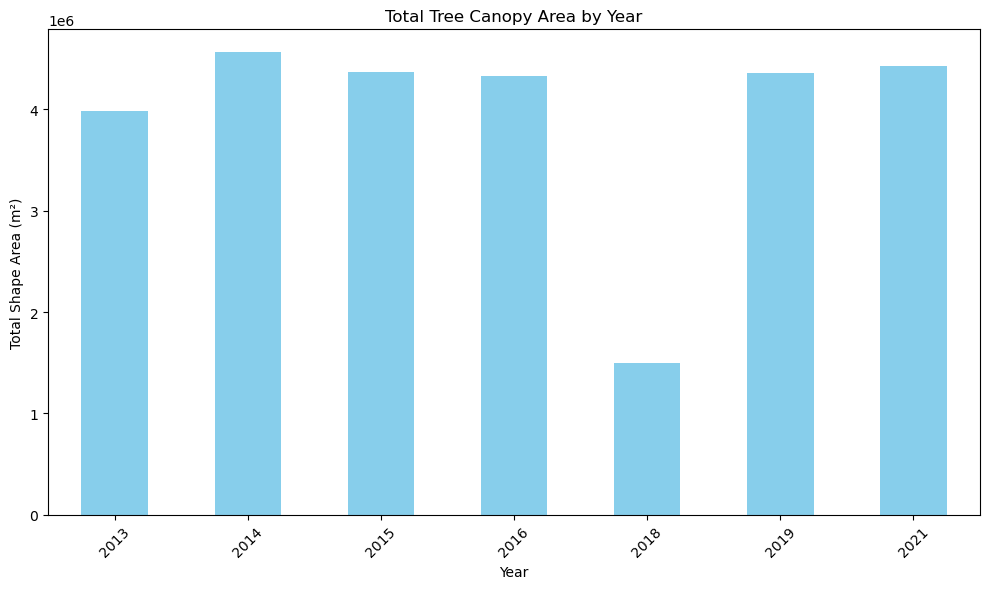

In [3]:
import matplotlib.pyplot as plt
# Read data from 2013-2021
merged_canopies = pd.read_csv("Data/Modified/canopies_all.csv") 
# Aggregate the total area by year
total_area_by_year = merged_canopies.groupby('year')['shape_area'].sum()

# Plot the results as a bar chart
total_area_by_year.plot(kind='bar', figsize=(10, 6),color='skyblue')

plt.title('Total Tree Canopy Area by Year')
plt.xlabel('Year')
plt.ylabel('Total Shape Area (m²)')
plt.xticks(rotation=45)  # Rotate the x-axis labels to show the years clearly
plt.tight_layout()  # Adjust the plot to ensure everything fits without overlapping
plt.show()

* Variations in Total Tree Canopy Area Over Time:

    Our exploratory analysis was extended by comparing the total tree canopy area across different years, as depicted in the bar plot. Notably, the data shows a substantial reduction in total canopy area in 2018. This dip corresponds with the geographical data from the heatmap, which indicates that canopy coverage was predominantly recorded in the northern parts of Melbourne for that year, missing extensive areas that were included in other years.

    From 2014 to 2019, there was a slight decrement in the total tree canopy area observed annually. This trend reverses from 2019 to 2021, where an increment in canopy area is noted. One plausible explanation for the increase in tree canopy coverage during the latter years could be the reduced human activity due to COVID-19 restrictions. The pandemic may have led to decreased urban development and maintenance activities, potentially allowing for more robust natural growth of tree canopies during this period.

### Number of data sample 

In [ ]:
# Count the number of data samples for each year
year_counts = merged_canopies['year'].value_counts().sort_index()

# Plot the results as a bar chart
year_counts.plot(kind='bar', figsize=(10, 6), color='skyblue')  # Choose a color for better visualization

plt.title('Number of Data Samples by Year')
plt.xlabel('Year')
plt.ylabel('Number of Samples')
plt.xticks(rotation=45)  # Rotate the x-axis labels to show the years clearly
plt.tight_layout()  # Adjust the plot to ensure everything fits without overlapping
plt.show()

* Data Sample Distribution Over Years:

    An initial examination of the dataset revealed fluctuations in the number of data samples collected annually from 2013 to 2021. As illustrated in the bar graph, the number of samples was particularly high in 2013, followed by a decrease in subsequent years, with a notable dip in 2018. The samples increased again in 2019 and decreased in 2021. This variance in sample size is crucial for interpreting changes in canopy coverage, as larger sample sizes can significantly influence visual representations and statistical analyses.

### percentage canopy of 2021 in PostCode

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline

canopies_with_districts = canopies_with_districts.groupby(['name', 'year'])['shape_area'].sum().reset_index()
canopies_2021 = canopies_with_districts[canopies_with_districts['year'] == 2021]
total_shape_area = canopies_2021['shape_area'].sum()
canopies_2021['percentage'] = (canopies_2021['shape_area'] / total_shape_area) * 100

canopies_2021_sorted = canopies_2021.sort_values('percentage')

# Creating the plot
plt.figure(figsize=(12, 6))  # Adjust the size as necessary
plt.bar(canopies_2021_sorted['name'], canopies_2021_sorted['percentage'], color='green')
plt.title('Percentage Canopy of 2021 by Postal Code')
plt.xlabel('Postal Code')
plt.ylabel('Canopy Percentage (%)')
plt.xticks(rotation=90)  # Rotate labels to avoid overlap
plt.tight_layout()  # Adjust layout to fit everything
plt.show()





# 4.Genre. Which genre of data story did you use?
The genre of data story is magazine
---

## Which tools did you use from each of the 3 categories of Visual Narrative (Figure 7 in Segal and Heer). Why?

* *Zooming*: Allows details from specific areas of the heatmap to be enlarged or focused, helping viewers understand localized changes in canopy density.

* *Establishing Shot / Splash Screen*: We using a plot to show the change of average temperature from 1910 to current, which indicating the city is getting hotter.

* *Feature Distinction*: Circling sensors that are spoken about in the article with red circles. And overall sensor locations with white dotted lines.

## Which tools did you use from each of the 3 categories of Narrative Structure (Figure 7 in Segal and Heer). Why?

* *Ordering*: The visualizations are presented in a logical sequence, starting with historical data and progressing towards the most recent data.

* *Interactivity*: Features like sliders to view different years on the heatmap are implemented, allowing viewers to actively engage with the data and explore different time points at their discretion. On the time-series plot, the postcode will display when user put cursor on it

* *Filtering*: In the Bokeh plot the user can hide or highlight temperature trends per postcode, allowing finer control to compare areas one to another.



# 5.Visualizations.
---

## Explain the visualizations you've chosen.
* Tree canopy data:
   * **Heatmap**:
    * **Purpose**: To visually represent the density and distribution of tree canopies across Melbourne over various years.


    * **Bar Charts (Annual Changes Plot)**:

    * **Purpose**: To show the quantitative change in tree canopy areas across different years, allowing for an easy comparison of data over time.

Visualisations of the relations with temperature and tree canopy:

* I have chosen the **3 visualisations** because they put forward the hypothesis that trees can positively impact temperature in urban climates. The Folium map allows me to harness the power of geospatial data easily showing density of trees over Inner subrubs of Melbourne and the overlayed with the individual sensor data showing temperature overtime. This is a really great way to draw conclusions (or not) with very large and complex data, plus it looks visually pleasing.
    * The Bokeh plot is to "zoom in" on the sensors, it's to show that areas with more trees might experience less rapid temperature changes.
    * The bar plot is a traditional way that is known to viewers as a way to show quantity in this case canopy area and then overlay it with another trend (temperature) to be able to concisely show correlation between the two.
   

## Why are they right for the story you want to tell?
* Tree canopy data:
    * **HeatMap** : Heatmaps are particularly effective for geographic data as they intuitively display density variations through color gradients. In our story about urban green spaces, heatmaps highlight areas with significant or lacking tree coverage, providing a clear visual distinction of the impact urban planning has on the environment. These visualizations help to illustrate the Heat Island Effect, showing regions that might be more susceptible to higher temperatures due to lower canopy coverage.

    * **Bar plot**: Bar charts are straightforward and provide a clear method for illustrating changes over time. In our case, bar charts offer a simple yet powerful tool to depict annual variations in tree coverage. 

* Sensor / temperature to canopy relations:
    * I have already touched on this point but I believe the 3 plots are the right way to visualise the data because, they are clear in the goal they are trying to analyse, they concisely summarise a very complicated and large amount of information, they can show trends that appear in data visually and importantly since this is a lay-reader web article, they are visually catching especially the charts with lots of nice shifting colours :) (like the heatmap with TimeSeriesChoropleth overlay)


# 6.Discussion. Think critically about your creation
---

## What went well?
* Effective Visualization: The use of heatmaps, bar charts, effectively conveyed the spatial and temporal trends of tree canopy coverage in Melbourne. These visual tools helped in illustrating complex data in an accessible manner, making it easier for the audience to understand the impact of urban greening.

* Data Integration: Successfully integrating temperature data with canopy coverage highlighted the ecological benefits of urban trees, particularly in mitigating the urban heat island effect. This integration allowed for a more holistic understanding of the environmental impacts of tree canopies

* There was some actual indications of trends visible with the relation of trees to temperature, this was visible through the 3 graphics generated.

* Managed to link and aggregate complex and massive geospatial datasets.

* Achieved a TimeSeriesChoropleth layer on a Folium map to visualise temporal data in an effective and visually impressive manner.

* Created a meaningful and impactful data driven story that had evidence backed arguments, with an outcome that can hopefully contribute positively to society (encourage sustainable methods to reduce climate change)

## What is still missing? What could be improved? Why?
* Adding an interactive plot to display the percentage of tree canopies in different areas across various years on heatmap. This interactive element would allow users to explore how tree coverage has evolved due to changes in urban development, policy implementation, or natural growth patterns.

* A lot of te arguments made based on the temperature data would not hold scientifically, that is because the temperature sensors are subjected very heavily to their environment and their concerntrations. So for example the postcode 3000 had a much large concetration of sensors than many other postcodes, this could lead to skewed data. Additionally while you could see a postcode has more trees, those sensors could've all been placed in very urban sections of that postcode giving a different indication than if they had a more even spread over many different parts.
    * Additionally we had to use the soil sensors, so therefore we operated under the impression they would give similar readings to atmospheric based temp. readings - however that layer of soil would definitely have a strong impact on the values and would lead to other uncontrollable variables like some soil might be more dense than others. However, this was the only comprehensive localised temperature dataset we could find that worked.
    * What could be improved? Perform our own sensor analysis with a gride of sensors over different urban conditions. This is the most sure way you understand variables. Alas, I understand this is not possible.

* Another thing that could be improved is the overall unity between the sections of the project, since we worked within a team of 3 we could have benefited greatly from sitting down and better fusing our analysis, findings and data story.
* Finally, I think that out Workbook has been very difficult to keep tidy and in flow, in the future we would introduce a better version mangagement or a better realtime way to update it together (git push and pull led to trouble). So that it is easier for the reader to see the phases of the project we went through.

* I think some really indepth and better analysis between the correlation of temperature and health data would have been both interesting and worthwhile to bolster the data story and extract more information from our hardwork processing and visualising data - so that's definitely something we could have improved on by adding.
    * the reason is simple we took the risk with working with very large and many datasets which ended up taking a lot of time to process and understand how to visualise, leaving us with less time to really nail the delivery.

# 7.Contributions. Who did what?
---

## You should write (just briefly) which group member was the main responsible for which elements of the assignment. (I want you guys to understand every part of the assignment, but usually there is someone who took lead role on certain portions of the work. That's what you should explain).


**Contribution Mikolaj:**
* Part 2 on website.
* Data aggregation and collection of useable datasets and research.
* Story outline.
* Sensor data cleaning and processing.
    * Aggregation of sensor data into larger grouped frames.
* Geospatial data cleaning and processing.
* Creation of GeoJSONs for postcode polygons.
* **Visualisations**
    * Tree density map with sensor temperature fluctuation (TimeSeriesChoropleth)
    * Bokeh map comparing sensor fluctuation using LOESS.
    * Bar graph showing canopy relation with temperature sensors, with LOESS trend.
* All associated data stories/discussion with the aforementioned visualisations.
* Contribution in part with Dario: Introduction to the data story 


**Contribution Qixin Ma**
* Qixin Ma responsible for the tree canopies data processing.
* Also responsible for geospatial joining and investigation of canopy data.
* Responsible for heatmap visualisation of tree density over the years.
* Part of the discussion in Part 1

**Contribution Dario Canistra**
* Website design, construction and hosting.
* Aggregating all our writing and graphics to build the website.
* Social data cleaning, processing.
* Social data bar graphics and health
* Part of the discussion and Part 1.
* Contribution in part with Mikolaj: Introduction to the data story 


---
# Code for data analysis for SENSOR BASED DATA:
* Sorry for not included it under the relevant sections however I could not seperate them without breaking the code.
* IN the future I would do the exploration and data cleaning seperately under the headings and then cast the dataframe.

---

## PLEASE NOTE: Realised this database was not as extensive as advertised on the database link. Decided to scrap this use

### Microclimate sensor readings (without timeseries) a stationary look at the impact of trees vs environmental readings:

* RH = Relative Humidity.
* WS = Wind speed


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import folium
import json
import geopandas

In [2]:
# Soil sensor readings data analysis:

# Import the sensor reading and locations datasets:

df_sensor_read = pd.read_csv("microclimate-sensor-readings.csv")
df_sensor_loc = pd.read_csv("microclimate-sensor-locations.csv")



In [3]:
# Append the reading dataset with the lat and lon of the sensor location (site:)
df_sensor_read_merge = df_sensor_read.merge(df_sensor_loc[['site_id', 'latitude', 'longitude']], on='site_id', how='left')
df_sensor_read_merge.head(10)

,local_time,id,site_id,sensor_id,value,type,units,gatewayhub_id,site_status,latitude,longitude
0,2023-11-29T22:15:02+00:00,8110553,1011,5b,74.38,TPH.RH,%,arc1055,C,-37.822222,144.952222
1,2023-11-29T22:15:02+00:00,8110558,1011,5c,1010.80,TPH.PRESSURE,hPa,arc1055,C,-37.822222,144.952222
2,2023-11-29T22:15:03+00:00,8110562,1011,6,0.00,WS,km/h,arc1055,C,-37.822222,144.952222
3,2023-11-29T22:15:04+00:00,8110606,1012,6,0.00,WS,km/h,arc1048,C,-37.813333,144.970000
4,2023-11-29T22:15:11+00:00,8110489,1009,0a,5.30,PM2.5,ug/m^3,arc1050,C,-37.816868,144.965705
5,2023-11-29T22:30:02+00:00,8110554,1011,5b,74.19,TPH.RH,%,arc1055,C,-37.822222,144.952222
6,2023-11-29T22:30:11+00:00,8110490,1009,0a,5.20,PM2.5,ug/m^3,arc1050,C,-37.816868,144.965705
7,2023-11-29T22:30:11+00:00,8110500,1009,0b,19.30,PM10,ug/m^3,arc1050,C,-37.816868,144.965705
8,2023-11-29T22:30:11+00:00,8110523,1011,0a,5.90,PM2.5,ug\/m^3,arc1055,C,-37.822222,144.952222
9,2023-11-29T22:30:11+00:00,8110532,1011,0b,24.80,PM10,ug\/m^3,arc1055,C,-37.822222,144.952222


In [4]:
# Convert the time/date col into parsable format:
df_sensor_read_merge['local_time'] = pd.to_datetime(df_sensor_read_merge['local_time'])

# Find the min and max dates so we know the range:
start_date = df_sensor_read_merge['local_time'].min()
end_date = df_sensor_read_merge['local_time'].max()

print("Start Date: ", start_date, "End Date: ", end_date)

Start Date:  2023-11-29 22:15:02+00:00 End Date:  2023-11-29 23:00:11+00:00


In [5]:
# Group by the location of the sensor:
df_id_1011 = df_sensor_read_merge[df_sensor_read_merge['site_id'] == 1011] #isolating the site IDs
df_id_1012 = df_sensor_read_merge[df_sensor_read_merge['site_id'] == 1012] 
df_id_1009 = df_sensor_read_merge[df_sensor_read_merge['site_id'] == 1009] 

# Site ID 1011 mean values:
df_id_1011_gType = df_id_1011.groupby(['type']).mean(numeric_only=True)
df_id_1011_gType.head()

# Site ID 1012 mean values:
df_id_1012_gType = df_id_1012.groupby(['type']).mean(numeric_only=True)
df_id_1012_gType.head()

# Site ID 1012 mean values:
df_id_1009_gType = df_id_1009.groupby(['type']).mean(numeric_only=True)
df_id_1009_gType.head()


,id,site_id,value,latitude,longitude
type,,,,,
PM10,8110500.5,1009.0,22.925,-37.816868,144.965705
PM2.5,8110490.5,1009.0,5.200,-37.816868,144.965705


### Plotting temperature overtime

<Axes: xlabel='local_time'>

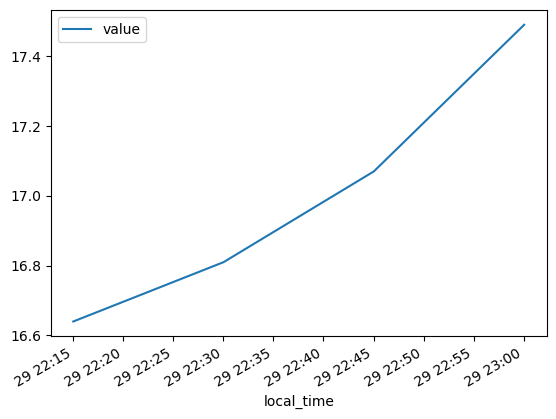

In [6]:
# Plot the temperature over time:
df_id_1011_temp = df_id_1011[df_id_1011['type'] == 'TPH.TEMP']

df_id_1011_temp.plot(x='local_time', y='value')

# SCRAPPED (left to show the analysis and cleaning that was undertaken to find the right dataset) Sensor readings, with temperature, light, humidity every 5 minutes at 8 locations DATASET:

* Trying similar as above but now with a more reobust dataset:

In [7]:
df_sensors = pd.read_csv("sensor-readings-with-temperature-light-humidity-every-5-minutes-at-8-locations-t.csv")

In [8]:
df_sensors.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 56570 entries, 0 to 56569
Data columns (total 21 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   timestamp     56570 non-null  object 
 1   mac           56570 non-null  object 
 2   boardtype     56570 non-null  int64  
 3   boardid       56570 non-null  int64  
 4   temp_max      56570 non-null  float64
 5   temp_min      56570 non-null  float64
 6   temp_avg      56570 non-null  float64
 7   light_max     56570 non-null  float64
 8   light_min     56570 non-null  float64
 9   light_avg     56570 non-null  float64
 10  humidity_min  56570 non-null  float64
 11  humidity_max  56570 non-null  float64
 12  humidity_avg  56570 non-null  float64
 13  model         56570 non-null  object 
 14  latitude      56570 non-null  float64
 15  longitude     56570 non-null  float64
 16  elevation     34975 non-null  float64
 17  location      56570 non-null  object 
 18  rowid         56570 non-nu

In [9]:
# Fix the date time:
df_sensors['timestamp'] = pd.to_datetime(df_sensors['timestamp'], utc=True)

# Find the min and max dates so we know the range:
start_date = df_sensors['timestamp'].min()
end_date = df_sensors['timestamp'].max()

print("Start Date: ", start_date, "End Date: ", end_date)



Start Date:  2014-12-15 01:40:00+00:00 End Date:  2015-06-05 04:15:00+00:00


In [10]:
# Groupby the location:
df_sensors_grouped_geolocation = df_sensors.groupby(['geolocation'])
df_sensors_grouped_location = df_sensors.groupby(['location']) # There are only two locations but 8 sensors within those locations.

df_sensors_grouped_location.size()

location
Docklands Library    42381
Fitzroy Gardens      14189
dtype: int64

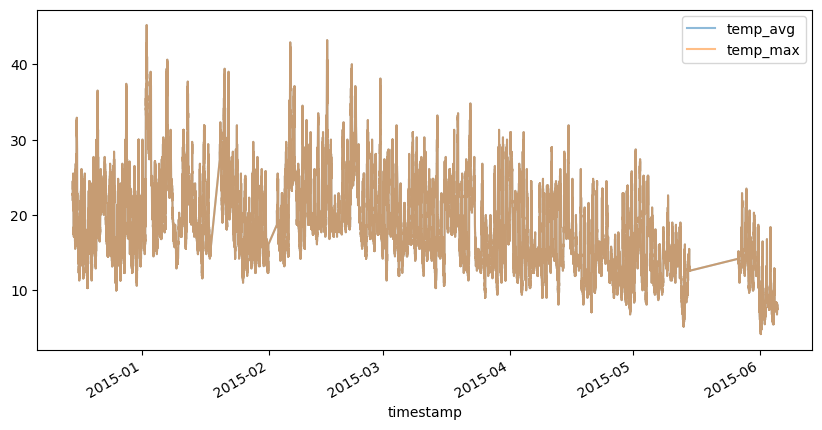

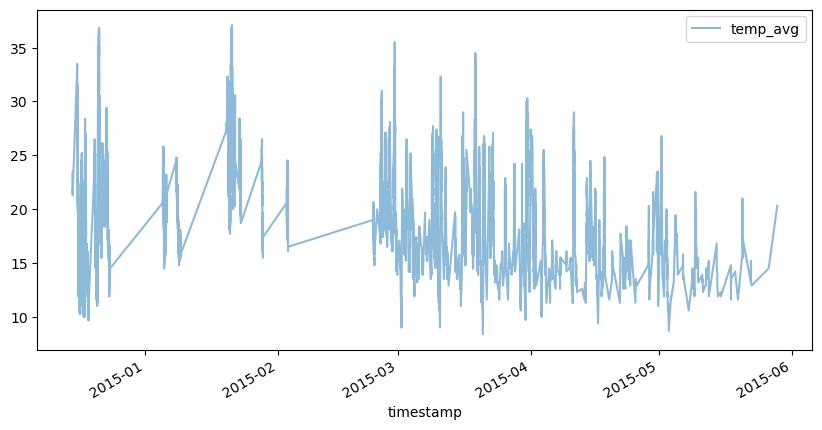

In [11]:
# Plotting a temperature curve for the library:
df_sensors_library = df_sensors[df_sensors['location'] == 'Docklands Library']

ax = df_sensors_library.plot(x='timestamp', y='temp_avg', figsize=(10,5), alpha=0.5)
df_sensors_library.plot(x='timestamp', y='temp_max', figsize=(10,5), ax=ax, alpha=0.5) # seems like max, min and avg are all the same
plt.show()

# Plotting temperature curve for Fitzroy Gardens
df_sensors_fitzroy = df_sensors[df_sensors['location'] == 'Fitzroy Gardens']
df_sensors_fitzroy.plot(x='timestamp', y='temp_avg', figsize=(10,5), alpha=0.5)
plt.show()

### Comparing two microclimate temperature locations:

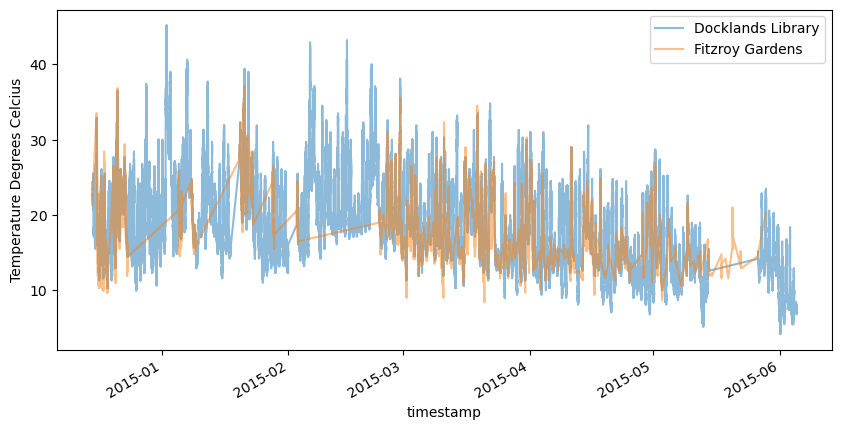

In [12]:
# Plot the two locations over each other to see if they experience similar weather:
ax = df_sensors_library.plot(x='timestamp', y='temp_avg', figsize=(10,5), alpha=0.5, label='Docklands Library')
ax.set_ylabel('Temperature Degrees Celcius')
df_sensors_fitzroy.plot(x='timestamp', y='temp_avg', figsize=(10,5), alpha=0.5, ax=ax, label='Fitzroy Gardens')
plt.show()

### Comparing light during the day:

In [13]:
# We will only look at one day because looking at the chart over the entire time series is essenitially just 0 to 100 (day and night), so we want to see the trend over the day.

# Creating a time mask for the period we want:
# * Lets take 2015-03-10

start_date = '2015-03-10 00:00:00+00:00'
end_date = '2015-03-10 23:59:59+00:00'

time_mask_library = (df_sensors_library['timestamp'] > start_date) & (df_sensors_library['timestamp'] <= end_date)
time_mask_fitzroy = (df_sensors_fitzroy['timestamp'] > start_date) & (df_sensors_fitzroy['timestamp'] <= end_date)

df_sensors_library_0310 = df_sensors_library.loc[time_mask_library]
df_sensors_fitzroy_0310 = df_sensors_fitzroy.loc[time_mask_fitzroy]





This is shows 1 day from 00:00 to 23:59

Counter intuitively the closer to the value of 100 means less light, and vice-versa I assume because the sensor is some kind of photo-voltaic resistor, when there is light it acts as a resistor.

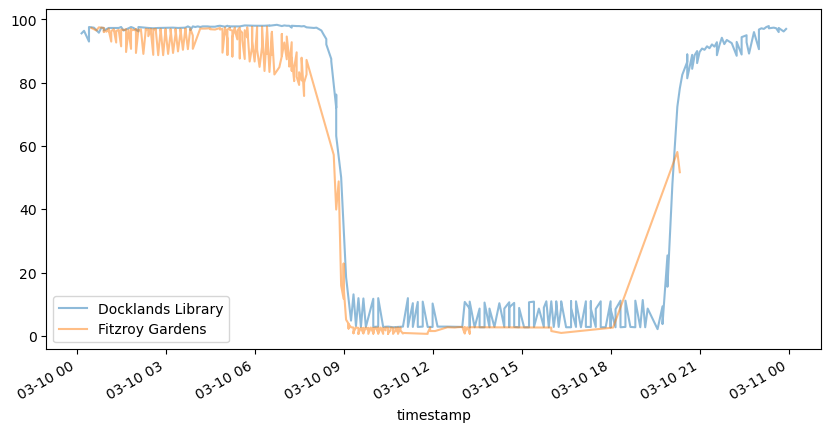

In [14]:
ax = df_sensors_library_0310.plot(x='timestamp', y='light_avg', figsize=(10,5), alpha=0.5, label='Docklands Library')
df_sensors_fitzroy_0310.plot(x='timestamp', y='light_avg', figsize=(10,5), alpha=0.5, ax=ax, label='Fitzroy Gardens')
plt.show()

Plotting the humidity curve for the same day:

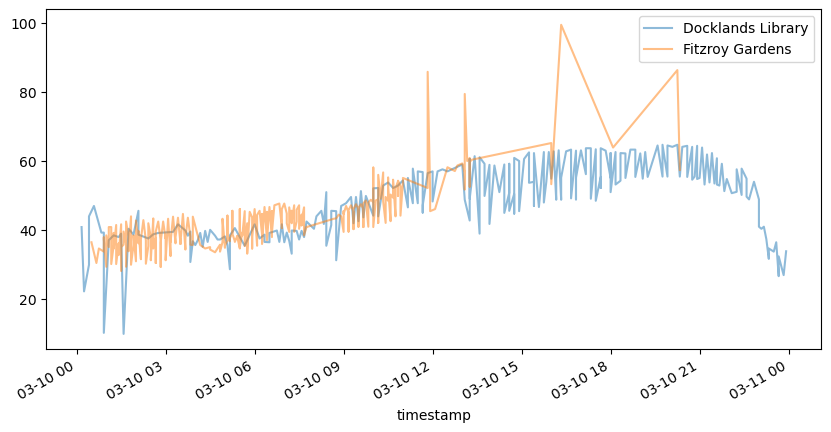

In [15]:
ax = df_sensors_library_0310.plot(x='timestamp', y='humidity_avg', figsize=(10,5), alpha=0.5, label='Docklands Library')
df_sensors_fitzroy_0310.plot(x='timestamp', y='humidity_avg', figsize=(10,5), alpha=0.5, ax=ax, label='Fitzroy Gardens')
plt.show()

# SCRAPPED (the soil sensors contained the same area) Adding another microclimate dataset (Argyle Square) - Park
* to bolster our dataset as two areas was not enough to get an idea

In [ ]:
df_argyle = pd.read_csv('argyle_meshed-sensor-type-1.csv')
df_argyle.head(25)

#read all the unique sensors ID's/positions:
unique_dev_ids = df_argyle['Lat Long'].unique()
print(unique_dev_ids)

# We can drop atmos41-0999 as it has no readings.


['-37.8022141, 144.9656262' nan]


In [ ]:
#Convert to date time as always:
df_argyle['date_measure'] = pd.to_datetime(df_argyle['date_measure'], utc=True)

# Drop the redundant sensor:
df_argyle = df_argyle[df_argyle['dev_id'] != 'atmos41-0999']


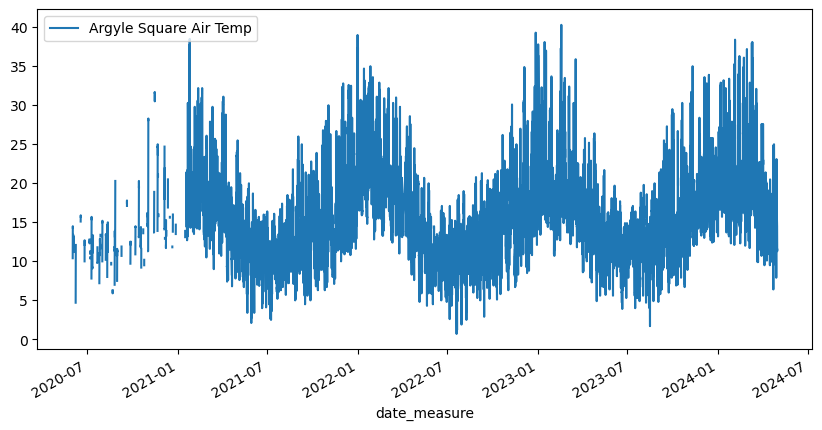

In [ ]:
# Plot what it look like over the years from 2020 - 2024!
df_argyle.plot(x='date_measure', y='airTemp', figsize=(10,5), alpha=1, label='Argyle Square Air Temp')
plt.show()

---

# Another climate sensor location Olympic Park:
* We can also use the other weather station location:
    * http://www.bom.gov.au/cgi-bin/climate/hqsites/site_data.cgi?period=annual&variable=maxT&station=087031
    * http://www.bom.gov.au/climate/change/hqsites/

In [19]:
df_olympic = pd.read_csv('bom-weather-at-olympic-park.csv')
df_olympic.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11359 entries, 0 to 11358
Data columns (total 43 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   local_date_time_full  11359 non-null  object 
 1   refresh_message       11359 non-null  object 
 2   ID                    11359 non-null  object 
 3   main_ID               11359 non-null  object 
 4   name                  11359 non-null  object 
 5   state_time_zone       11359 non-null  object 
 6   time_zone             11359 non-null  object 
 7   product_name          11359 non-null  object 
 8   state                 11359 non-null  object 
 9   sort_order            11359 non-null  int64  
 10  wmo                   11359 non-null  int64  
 11  history_product       11359 non-null  object 
 12  local_date_time       11359 non-null  object 
 13  aifstime_utc          11359 non-null  int64  
 14  lat                   11359 non-null  float64
 15  lon                

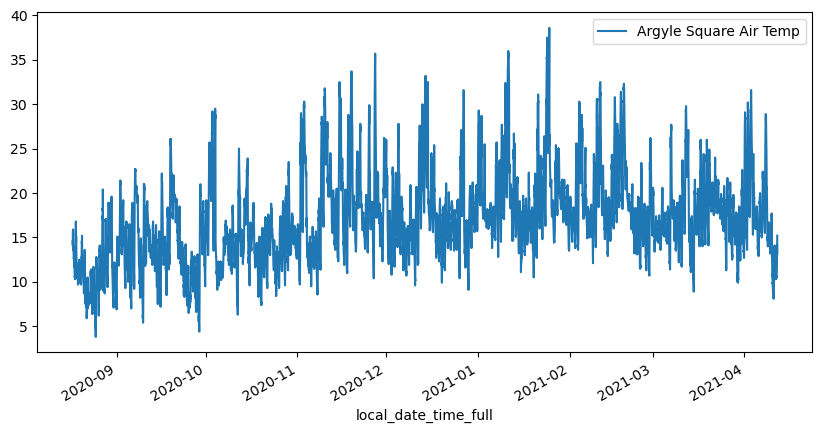

In [20]:
df_olympic['local_date_time_full'] = pd.to_datetime(df_olympic['local_date_time_full'], utc=True)

df_olympic.plot(x='local_date_time_full', y='air_temp', figsize=(10,5), alpha=1, label='Argyle Square Air Temp')
plt.show()

In [21]:
df_olympic.head()

,local_date_time_full,refresh_message,ID,main_ID,name,state_time_zone,time_zone,product_name,state,sort_order,...,sea_state,swell_dir_worded,swell_height,swell_period,vis_km,weather,wind_dir,wind_spd_kmh,wind_spd_kt,latlong
0,2020-08-17 04:30:00+00:00,Issued at 2:41 pm EST Monday 17 August 2020,IDV60901,IDV60900,Melbourne (Olympic Park),VIC,EST,Capital City Observations,Victoria,0,...,-,-,NaN,NaN,10.0,-,SW,7,4,"-37.8, 145.0"
1,2020-08-17 05:00:00+00:00,Issued at 3:11 pm EST Monday 17 August 2020,IDV60901,IDV60900,Melbourne (Olympic Park),VIC,EST,Capital City Observations,Victoria,0,...,-,-,NaN,NaN,10.0,-,WNW,9,5,"-37.8, 145.0"
2,2020-08-17 03:30:00+00:00,Issued at 1:41 pm EST Monday 17 August 2020,IDV60901,IDV60900,Melbourne (Olympic Park),VIC,EST,Capital City Observations,Victoria,0,...,-,-,NaN,NaN,10.0,-,WNW,4,2,"-37.8, 145.0"
3,2020-08-17 16:30:00+00:00,Issued at 2:41 am EST Tuesday 18 August 2020,IDV60901,IDV60900,Melbourne (Olympic Park),VIC,EST,Capital City Observations,Victoria,0,...,-,-,NaN,NaN,10.0,-,N,19,10,"-37.8, 145.0"
4,2020-08-17 17:00:00+00:00,Issued at 3:11 am EST Tuesday 18 August 2020,IDV60901,IDV60900,Melbourne (Olympic Park),VIC,EST,Capital City Observations,Victoria,0,...,-,-,NaN,NaN,10.0,-,N,15,8,"-37.8, 145.0"


C:\Users\mikus\AppData\Local\Temp\ipykernel_6568\3605788258.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_olympic_0310['time'] = df_olympic_0310['local_date_time_full'].dt.time


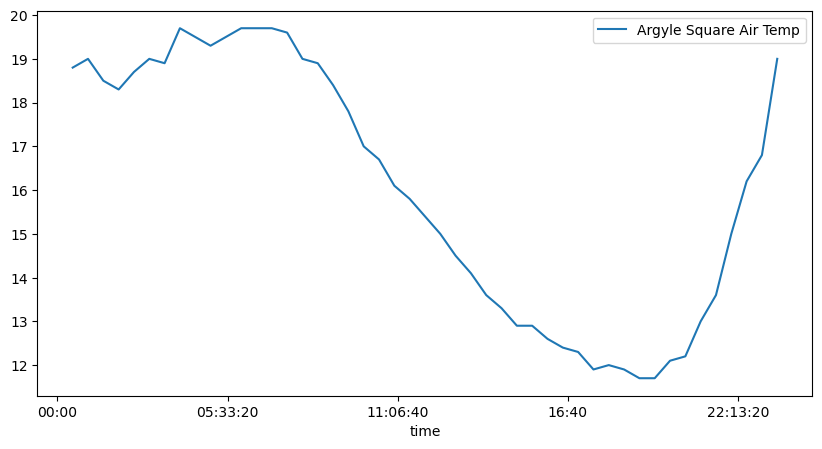

In [22]:
#Delocalise the datetime:
df_olympic['local_date_time_full'] = df_olympic['local_date_time_full'].dt.tz_localize(None)

# For one day:
start_date = '2021-03-10 00:00:00'
end_date = '2021-03-10 23:59:59'


time_mask_olympic = (df_olympic['local_date_time_full'] > start_date) & (df_olympic['local_date_time_full'] <= end_date)

df_olympic_0310 = df_olympic.loc[time_mask_olympic]

df_olympic_0310['time'] = df_olympic_0310['local_date_time_full'].dt.time

df_olympic_0310 = df_olympic_0310.sort_values('time') #sort the time ascending

df_olympic_0310.plot(x='time', y='air_temp', figsize=(10,5), alpha=1, label='Argyle Square Air Temp')
plt.show()
#df_olympic_0310.head(5)

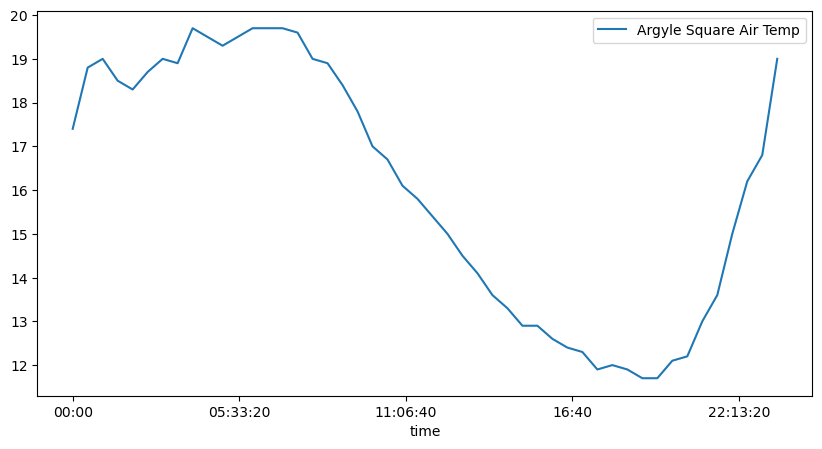

In [23]:
# Something wrong with the above code:
#Make a col that seperates TIME and DATE:
df_olympic['time'] = df_olympic['local_date_time_full'].dt.time
df_olympic['date'] = df_olympic['local_date_time_full'].dt.date


df_olympic.head()
df_olympic_0311 = df_olympic[df_olympic['date'] == pd.to_datetime('2021-03-10').date()]


df_olympic_0311.plot(x='time', y='air_temp', figsize=(10,5), alpha=1, label='Argyle Square Air Temp')
plt.show()

**NOTE: To make the observations with the climate/temp data we will have to then compare it to averages/large datasets like overall weather data recorded in Melb from the BOM daily temp report as example... this way we can show those higher tree density areas might experience lower temperature to the overall mean temp seen in the city** I see no other way to do these comparisons otherwise...

* We should consider those biodiversity datasets as well to get some content in.

* MOST importantly it will be the community satisfaction one I believe / socio-economics with areas with more trees, since we have MORE widespread localised data.

# SOIL SENSOR cleaning, analysis and generation of Bokeh, Folium and Bar graphics for the website
* Because we have very sparse data for ambient temperature readings, we have to use soil sensors which are far more plentiful throughout Melbourne and we can still extract some meaningful insights from the data.

## Data cleaning

In [24]:
df_soil22 = pd.read_csv('soil-sensor-readings-historical-data-2022.csv')
df_soil22.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4283583 entries, 0 to 4283582
Data columns (total 11 columns):
 #   Column            Dtype  
---  ------            -----  
 0   date_time         object 
 1   site_name         object 
 2   site_id           int64  
 3   id                int64  
 4   date              object 
 5   time              object 
 6   probe_id          int64  
 7   probe_measure     object 
 8   soil_value        float64
 9   unit              object 
 10  json_featuretype  object 
dtypes: float64(1), int64(3), object(7)
memory usage: 359.5+ MB


In [25]:
df_soil22_location = pd.read_csv('soil-sensor-locations.csv')

# Rename the site_name cols to match!
df_soil22_location = df_soil22_location.rename(columns={'Site_Name': 'site_name'})
df_soil22_location = df_soil22_location.rename(columns={'Site_ID': 'site_id'})

df_soil22_location = df_soil22_location.rename(columns={'Longitude': 'longitude'})
df_soil22_location = df_soil22_location.rename(columns={'Latitude': 'latitude'})

df_soil22_location.head()

,site_id,site_name,Property_Name,latitude,longitude,Location
0,50921,Replaced by op63369,Fitzroy Gardens,-37.810827,144.981787,"-37.81082691661315, 144.98178719594011"
1,50924,Fitzroy West 09,Fitzroy Gardens,-37.810675,144.979618,"-37.81067469320403, 144.979618148459"
2,64971,5th Fairway,Royal Park,-37.779210,144.952510,"-37.77920999998876, 144.95251000000945"
3,64973,Argyle Square,Argyle Square,-37.802902,144.966011,"-37.8029015228744, 144.966010728849"
4,64976,9th Fairway,Royal Park,-37.782920,144.955660,"-37.78291999998904, 144.95566000000628"


In [26]:
df_soil22.head()

,date_time,site_name,site_id,id,date,time,probe_id,probe_measure,soil_value,unit,json_featuretype
0,2021-12-31T13:00:00+00:00,Royal Parade Opposite Lawn 5,91577,10625573,2022-01-01,00:00:00,2031637,Soil Salinity 20cm,0.13,µS/cm,SoilSensorData
1,2021-12-31T13:00:00+00:00,9th Fairway,64976,10625819,2022-01-01,00:00:00,1304173,Soil Moisture 30cm #0,16.04,%VWC,SoilSensorData
2,2021-12-31T13:00:00+00:00,Royal Parade CSIRO,88403,10625929,2022-01-01,00:00:00,2031667,Soil Temperature 50cm,18.08,ºC,SoilSensorData
3,2021-12-31T13:00:00+00:00,Princess bridge SW p10,101034,10626071,2022-01-01,00:00:00,2019288,Soil Salinity 20cm,0.03,µS/cm,SoilSensorData
4,2021-12-31T13:00:00+00:00,Princess bridge West p06,101035,10626112,2022-01-01,00:00:00,2019308,Soil Salinity 20cm,0.25,µS/cm,SoilSensorData


Found out I could not merge by site_name as there are some inconsistencies with the naming. Have to do it by site_id. Below is how I came to the conclusion.

In [27]:
# Check if all values in 'site_name' of df_soil22 are in 'site_name' of df_soil22_location
all_values_present = df_soil22['site_name'].isin(df_soil22_location['site_name']).all()
print(all_values_present)

False


In [28]:
# Check if all values in 'site_id' of df_soil22 are in 'Site_ID' of df_soil22_location
all_values_present = df_soil22['site_id'].isin(df_soil22_location['site_id']).all()
print(all_values_present)

True


In [29]:
# Append the location data to the df (do it by site_name):
df_soil22_merge = df_soil22.merge(df_soil22_location[['site_id', 'latitude', 'longitude']], on='site_id', how='left')
df_soil22_merge.head()

,date_time,site_name,site_id,id,date,time,probe_id,probe_measure,soil_value,unit,json_featuretype,latitude,longitude
0,2021-12-31T13:00:00+00:00,Royal Parade Opposite Lawn 5,91577,10625573,2022-01-01,00:00:00,2031637,Soil Salinity 20cm,0.13,µS/cm,SoilSensorData,-37.780909,144.960163
1,2021-12-31T13:00:00+00:00,9th Fairway,64976,10625819,2022-01-01,00:00:00,1304173,Soil Moisture 30cm #0,16.04,%VWC,SoilSensorData,-37.782920,144.955660
2,2021-12-31T13:00:00+00:00,Royal Parade CSIRO,88403,10625929,2022-01-01,00:00:00,2031667,Soil Temperature 50cm,18.08,ºC,SoilSensorData,-37.786120,144.959012
3,2021-12-31T13:00:00+00:00,Princess bridge SW p10,101034,10626071,2022-01-01,00:00:00,2019288,Soil Salinity 20cm,0.03,µS/cm,SoilSensorData,-37.819897,144.968499
4,2021-12-31T13:00:00+00:00,Princess bridge West p06,101035,10626112,2022-01-01,00:00:00,2019308,Soil Salinity 20cm,0.25,µS/cm,SoilSensorData,-37.819346,144.968226


In [30]:
# Sort for Temperature readings only:
df_soil22_temperature = df_soil22_merge[df_soil22_merge['unit'] == 'ºC']

In [31]:
# Group the sites together so we can linear time data for all the different sensors.
df_soil22_temperature_grouped = df_soil22_temperature.groupby("site_id")


In [32]:
print(df_soil22_temperature_grouped)

## Making a TimeSliderCloropleth map to show the changing readings over time on a map
* This can then be overlayed with the tree denisty measurements
* https://python-visualization.github.io/folium/latest/user_guide/plugins/timeslider_choropleth.html

### Create polygon circles for the markers so they can be edited by the Chloropleth timeseries
It was not possible to use folium markers to contain the colour data PER epoch

In [33]:
import geopandas as gpd
from shapely.geometry import Point

# Create a list of points from the lat and lon of the df
points = []
site_id_list = []

for group_name, df_group in df_soil22_temperature_grouped:
    lat = df_group['latitude'].iloc[0] #grab the first row of the group to just get lat and lon of that group
    lon = df_group['longitude'].iloc[0]
    site_id = df_group['site_id'].iloc[0]
    points.append(Point(lon, lat))
    site_id_list.append(site_id)

#Create a combined dictionary to add into a geodataframe
d = {'site_id':site_id_list, 'geometry':points}
# Create a geo dataframe: using world map projection standard (not sure if GDA2020 would give better accuracy since our data is probably on the Aussie datum)
gdf = gpd.GeoDataFrame(d, crs="EPSG:4326")

# Use the buffer method to create circles around the points
# Replace 0.01 with the actual radius you want
gdf['geometry'] = gdf['geometry'].buffer(0.0015)

# Export the GeoDataFrame as a GeoJSON file
gdf.to_file("circles_test.geojson", driver='GeoJSON')

C:\Users\mikus\AppData\Local\Temp\ipykernel_6568\1298889465.py:22: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf['geometry'] = gdf['geometry'].buffer(0.0015)


### Creating the colour scale values for the temperature data.

Testing the polygon circle markers!

In [34]:
# REMOVE ALL NaN values otherwise we cannot apply colourmap!!
df_soil22_temperature_clean = df_soil22_temperature.dropna(subset=['soil_value'])

#Drop UTC time stamp and convert to datatime
df_soil22_temperature_clean['date_time'] = pd.to_datetime(df_soil22_temperature_clean['date_time'])
df_soil22_temperature_clean['date_time'] = df_soil22_temperature_clean['date_time'].dt.tz_localize(None)


C:\Users\mikus\AppData\Local\Temp\ipykernel_6568\2082117709.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_soil22_temperature_clean['date_time'] = pd.to_datetime(df_soil22_temperature_clean['date_time'])
C:\Users\mikus\AppData\Local\Temp\ipykernel_6568\2082117709.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_soil22_temperature_clean['date_time'] = df_soil22_temperature_clean['date_time'].dt.tz_localize(None)


### Note something I missed: probe depth matters in the analysis
Since the probes are at different depths they will all experience different temperature fluctuations. So lets build a new dataframe with only depths of 10cm and 20cm (closest to surface temp)

In [35]:
df_soil22_temperature_clean['probe_measure'].unique()


array(['Soil Temperature 50cm', 'Soil Temperature 20cm',
       'Soil Temperature 60cm', 'Soil Temperature 10cm #0',
       'Soil Temperature 30cm', 'Soil Temperature 40cm',
       'Soil Temperature 10cm', 'Soil Temperature 20cm #0',
       'Soil Temperature 30cm #0', 'Soil Temperature 80cm #0',
       'Soil Temperature 50cm #0', 'Soil Temperature 60cm #0',
       'Soil Temperature 40cm #0', 'Soil Temperature 70cm #0',
       'Soil Temperature 80cm', 'Soil Temperature 70cm',
       'Soil Temperature 050cm', 'Soil Temperature 070cm',
       'Soil Temperature 040cm', 'Soil Temperature 060cm',
       'Soil Temperature 080cm', 'Soil Temperature 030cm',
       'Soil Temperature 020cm', 'Soil Temperature 010cm'], dtype=object)

In [36]:
filter_values = ['Soil Temperature 020cm', 'Soil Temperature 010cm', 'Soil Temperature 20cm #0', 'Soil Temperature 10cm #0', 'Soil Temperature 10cm']
df_soil22_temperature_clean_filterdepth =  df_soil22_temperature_clean[df_soil22_temperature_clean['probe_measure'].isin(filter_values)]

In [37]:
df_soil22_temperature_clean_filterdepth.head()

df_cloned_before_timelimit = df_soil22_temperature_clean_filterdepth 

In [38]:
# Limit the data set for a certain period:
start_date = '2022-03-01 00:00:00'
end_date = '2022-06-01 00:00:00'


time_mask_soil = (df_soil22_temperature_clean_filterdepth['date_time'] > start_date) & (df_soil22_temperature_clean_filterdepth['date_time'] <= end_date)

df_soil22_temperature_clean_filterdepth = df_soil22_temperature_clean_filterdepth.loc[time_mask_soil]

In [39]:
# Convert datetime to epochs to use in the chorolpleth
def datetime_to_ms(dt):
    return int(dt.timestamp())

In [40]:
from branca.colormap import linear
from folium.plugins import TimeSliderChoropleth

#colormap = linear.PuRd_09.scale(df_soil22_temperature_clean_filterdepth['soil_value'].min(), df_soil22_temperature_clean_filterdepth['soil_value'].max())
colormap = linear.YlOrRd_09.scale(df_soil22_temperature_clean_filterdepth['soil_value'].min(), df_soil22_temperature_clean_filterdepth['soil_value'].max())


# COLOR DICT GENERATION
#color_dict = {row.date_time: colormap(row.soil_value) for row in df_soil22_temperature_clean.itertuples()}

color_dict = {site_id: {datetime_to_ms(row.date_time): {'color': colormap(row.soil_value), 'opacity': 0.9} for row in group.itertuples()} 
              for site_id, group in df_soil22_temperature_clean_filterdepth.groupby('site_id')}

#df_soil22_temperature_color = df_soil22_temperature # Cloning the df

#df_soil22_temperature_color['color'] = df_soil22_temperature_color['soil_value'].apply(colormap)




In [42]:
# Test to see how the dictionary looks
color_dict

{50924: {1650117600: {'color': '#fe9840ff', 'opacity': 0.9},
  1650103200: {'color': '#fe933eff', 'opacity': 0.9},
  1650110400: {'color': '#fe9640ff', 'opacity': 0.9},
  1649923200: {'color': '#fe9941ff', 'opacity': 0.9},
  1650096000: {'color': '#fe913dff', 'opacity': 0.9},
  1650218400: {'color': '#fe8f3dff', 'opacity': 0.9},
  1650204000: {'color': '#fe8f3dff', 'opacity': 0.9},
  1650182400: {'color': '#fe8d3cff', 'opacity': 0.9},
  1651579200: {'color': '#feb24cff', 'opacity': 0.9},
  1651600800: {'color': '#feb04bff', 'opacity': 0.9},
  1651572000: {'color': '#feb04bff', 'opacity': 0.9},
  1653300000: {'color': '#fed975ff', 'opacity': 0.9},
  1653328800: {'color': '#fed976ff', 'opacity': 0.9},
  1653213600: {'color': '#fed773ff', 'opacity': 0.9},
  1653220800: {'color': '#fed773ff', 'opacity': 0.9},
  1653228000: {'color': '#fed773ff', 'opacity': 0.9},
  1653141600: {'color': '#fed471ff', 'opacity': 0.9},
  1653134400: {'color': '#fed571ff', 'opacity': 0.9},
  1653055200: {'color

In [43]:
gdf = gdf.set_index('site_id')

In [105]:
lat = -37.82100364730375
lon = 144.97616157306933
map_melb_soil_geo = folium.Map(location=[lat, lon], zoom_start=13, tiles="Cartodb dark_matter")

#Load the created GeoJSON
with open('circles_test.geojson') as f:
    circle_geo = json.load(f)

# folium.GeoJson(circle_geo, tooltip=folium.features.GeoJsonTooltip(
#         fields=['site_id'],
#         aliases=['Site ID:'],
#     )).add_to(map_melb_soil_geo)

TimeSliderChoropleth(gdf.to_json(), styledict=color_dict).add_to(map_melb_soil_geo)

# Make the background of the colormap legend easier to see (hacky solution)
svg_style = '<style>svg#legend {background-color: white;}</style>'
map_melb_soil_geo.get_root().header.add_child(folium.Element(svg_style))
colormap.caption = 'Degrees Celcius'
colormap.add_to(map_melb_soil_geo)



Load the 2021 canopies to display them under the sensors to be able to better see the trends.

In [106]:
from folium.plugins import HeatMap
canopies_2021 = pd.read_csv("E:\DTU\S2_2024\SocialData\Assignments\FinalProj\Datasets\canopies_2021.csv")

# Prepare the heatmap data for 2021
heatmap_data_2021 = canopies_2021.apply(
    lambda row: [float(row['Geo Point'].split(',')[0]), float(row['Geo Point'].split(',')[1])],axis=1).tolist()

heatmap = HeatMap(data=heatmap_data_2021, 
                  blur=5, radius=9, gradient={0: '#FF0000', 0.17: '#FF7F00', 0.34: '#FFFF00', 0.51: '#00FF00', 0.68: '#0000FF', 0.85: '#9400D3', 1: '#f6e0ff'})

heatmap.add_to(map_melb_soil_geo)
folium.Circle(location=[-37.812654095560696, 144.98749403906933], radius=300, popup='Marker 1, Postcode:3002', stroke=True, fill=False, color='red', weight=2.5).add_to(map_melb_soil_geo)
folium.Circle(location=[-37.81922857381169, 144.96826862571965], radius=275, popup='Marker 2, Postcode:3000', stroke=True, fill=False, color='red', weight=2.5).add_to(map_melb_soil_geo)
folium.Circle(location=[-37.813892182539526, 144.96437134879744], radius=275, popup='Marker 3, Postcode:3000', stroke=True, fill=False, color='red', weight=2.5).add_to(map_melb_soil_geo)
map_melb_soil_geo


In [107]:
# Save the map as a html:
map_melb_soil_geo.save('soil_sensor_canopy_density_map.html')

## Creating a shapefile for Melbourne suburbs and a list of the North, East, West and South divide:


In [50]:
import json

# Load the geojson:
with open('vicboundaries.json') as f:
    vicsub = json.load(f)

In [51]:
# Filter data
filtered_data = [item for item in vicsub['features'] if item['properties']['loc_pid'].startswith('VIC') and '3101' <= item['properties']['loc_pid'] <= 'VIC3148']

# Sort data
sorted_data = sorted(filtered_data, key=lambda x: x['properties']['loc_pid'])


# Save sorted data to a new JSON file
with open('Eastern_Suburbs.json', 'w') as file:
    json.dump(filtered_data, file)

Ranges of the melbourne NSEW division based on this list:
http://www.impactlists.com.au/ImpactLists/media/list-tools/Useful-Postcode-Ranges.pdf

In [52]:
# Merging the large dataset of individual melbourne post codes:

import glob
import os

postcode_ranges_E = [(3101, 3148)]
postcode_ranges_W = [(3011, 3044)]
postcode_ranges_N = [(3047, 3100)]
postcode_ranges_S = [(3149, 3207)]
postcode_ranges_INNER = [(3000, 3010)]


directory = 'E:/DTU\S2_2024/SocialData/Assignments/FinalProj/Datasets/GEOJSONS/australian-suburbs-master/GeoJSON/vic_postcodes'

# Dict to hold merge
merged_data = {"type": "FeatureCollection", "features": []}

# Get a list of all JSON files in the directory
files = glob.glob(os.path.join(directory, '*.json'))

# Process each file (EAST)
for file in files:
    # Extract the postcode from the filename
    postcode = int(os.path.splitext(os.path.basename(file))[0])
    for range in postcode_ranges_INNER:
        if range[0] <= postcode <= range[1]:
            with open(file, 'r') as f:
                data = json.load(f)
                merged_data["features"].append(data)
            break

# Write the merged data to a new JSON file
with open('geo_postcode_Inner.json', 'w') as f:
    json.dump(merged_data, f)



## Cleaning, filtering and plotting the soil sensor data frame 
to see what sort of trends and fun data magic vizardry we can perform

In [53]:
 # Load GeoDataFrames
north = gpd.read_file('geo_postcode_East.json')
east = gpd.read_file('geo_postcode_Inner.json')
south = gpd.read_file('geo_postcode_North.json')
west = gpd.read_file('geo_postcode_South.json')
inner = gpd.read_file('geo_postcode_West.json')

# Combine and filter GeoDataFrames (we need to filter the postcodes to be a smaller so it fits the data we have)
# In all honesty I could regenerate the geojson postcodes to be smaller but I'm being lazy here.
postcode = ["3000","3002","3003","3004","3005","3006","3008","3010","3031","3032","3121","3141","3205","3207", "3053", "3052", "3054"]
melb_subdistricts = gpd.GeoDataFrame(pd.concat([north, east, south, west, inner], ignore_index=True))
melb_subdistricts = melb_subdistricts[melb_subdistricts['name'].isin(postcode)]

In [54]:
melb_subdistricts.set_index('name')

,geometry
name,
3121,"POLYGON ((144.99135 -37.80973, 144.99198 -37.8..."
3141,"POLYGON ((144.98793 -37.82962, 144.98839 -37.8..."
3000,"POLYGON ((144.97136 -37.80773, 144.97168 -37.8..."
3002,"POLYGON ((144.97136 -37.80773, 144.97319 -37.8..."
3003,"POLYGON ((144.91649 -37.79821, 144.91973 -37.7..."
3004,"POLYGON ((144.97041 -37.83016, 144.97132 -37.8..."
3005,"POLYGON ((144.95507 -37.82110, 144.95515 -37.8..."
3006,"POLYGON ((144.94793 -37.82339, 144.94836 -37.8..."
3008,"POLYGON ((144.92037 -37.82003, 144.91989 -37.8..."


In [55]:
df_soil22_temperature_clean_filterdepth

,date_time,site_name,site_id,id,date,time,probe_id,probe_measure,soil_value,unit,json_featuretype,latitude,longitude
1601,2022-04-16 08:30:00,Princess bridge SW p10,101034,12116499,2022-04-16,18:30:00,2019282,Soil Temperature 10cm,19.22,ºC,SoilSensorData,-37.819897,144.968499
1619,2022-04-16 11:00:00,Royal Parade Opposite Lawn 5,91577,12116544,2022-04-16,21:00:00,2031627,Soil Temperature 10cm,16.40,ºC,SoilSensorData,-37.780909,144.960163
1625,2022-04-16 11:30:00,Princess bridge NE p11,101037,12116580,2022-04-16,21:30:00,2019343,Soil Temperature 10cm,18.32,ºC,SoilSensorData,-37.818811,144.968165
1971,2022-04-16 14:30:00,Princess bridge NW p01,101032,12116795,2022-04-17,00:30:00,2019262,Soil Temperature 10cm,19.74,ºC,SoilSensorData,-37.818868,144.967975
1987,2022-04-16 06:30:00,Bourke South 3,88425,12116863,2022-04-16,16:30:00,1914087,Soil Temperature 10cm,19.87,ºC,SoilSensorData,-37.813741,144.965109
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4283493,2022-03-01 15:00:00,Ransford Oval,65010,11493200,2022-03-02,02:00:00,1304327,Soil Temperature 20cm #0,20.37,ºC,SoilSensorData,-37.778750,144.955550
4283556,2022-03-01 05:00:00,Fitzroy Gardens East '18,64990,11492677,2022-03-01,16:00:00,1305882,Soil Temperature 20cm #0,20.28,ºC,SoilSensorData,-37.813227,144.981580
4283560,2022-03-01 13:00:00,Batman Park,75504,11492713,2022-03-02,00:00:00,1618926,Soil Temperature 20cm #0,20.36,ºC,SoilSensorData,-37.821919,144.956368
4283561,2022-03-01 05:00:00,Carlton Gardens North,64979,11493466,2022-03-01,16:00:00,1306518,Soil Temperature 10cm #0,20.75,ºC,SoilSensorData,-37.801700,144.971380


In [56]:
# To compute which sensors exisit in which postcode we need to
# perform a spatial join, this way we can get the mean
# sensor fluctuations per postcode.

# We have to making the dataframe containing all sensor data have the lat and lon as geometry col.

df_soil22_temperature_clean_filterdepth['location'] = df_soil22_temperature_clean_filterdepth.apply(lambda row: Point(row.longitude, row.latitude), axis=1)
gdf_sensors = gpd.GeoDataFrame(df_soil22_temperature_clean_filterdepth, geometry='location')

df_pcode_sensor_depth_filtered_0322 = gpd.sjoin(gdf_sensors, melb_subdistricts, how="left", op='within')

C:\Users\mikus\AppData\Local\Temp\ipykernel_6568\2850473792.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_soil22_temperature_clean_filterdepth['location'] = df_soil22_temperature_clean_filterdepth.apply(lambda row: Point(row.longitude, row.latitude), axis=1)
c:\Users\mikus\anaconda3\envs\course02502\lib\site-packages\IPython\core\interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
C:\Users\mikus\AppData\Local\Temp\ipykernel_6568\2850473792.py:10: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the in

In [57]:
df_soil22_temperature_clean_filterdepth.head()

,date_time,site_name,site_id,id,date,time,probe_id,probe_measure,soil_value,unit,json_featuretype,latitude,longitude,location
1601,2022-04-16 08:30:00,Princess bridge SW p10,101034,12116499,2022-04-16,18:30:00,2019282,Soil Temperature 10cm,19.22,ºC,SoilSensorData,-37.819897,144.968499,POINT (144.9684992061251 -37.81989716461172)
1619,2022-04-16 11:00:00,Royal Parade Opposite Lawn 5,91577,12116544,2022-04-16,21:00:00,2031627,Soil Temperature 10cm,16.40,ºC,SoilSensorData,-37.780909,144.960163,POINT (144.9601629999941 -37.78090899998983)
1625,2022-04-16 11:30:00,Princess bridge NE p11,101037,12116580,2022-04-16,21:30:00,2019343,Soil Temperature 10cm,18.32,ºC,SoilSensorData,-37.818811,144.968165,POINT (144.968165187284 -37.81881082805113)
1971,2022-04-16 14:30:00,Princess bridge NW p01,101032,12116795,2022-04-17,00:30:00,2019262,Soil Temperature 10cm,19.74,ºC,SoilSensorData,-37.818868,144.967975,POINT (144.9679752533576 -37.81886786690239)
1987,2022-04-16 06:30:00,Bourke South 3,88425,12116863,2022-04-16,16:30:00,1914087,Soil Temperature 10cm,19.87,ºC,SoilSensorData,-37.813741,144.965109,POINT (144.9651085587028 -37.8137412725723)


CHECK TO SEE IF ANY GEOSPATIAL DATA HAS NOT BEEN ASSIGNED (NaN rows). If empty display then we are good

In [58]:
nan_rows = df_pcode_sensor_depth_filtered_0322.isna()
# To get the rows with any NaN values
rows_with_nan = nan_rows.any(axis=1)
# To display the rows with NaN values
df_pcode_sensor_depth_filtered_0322[rows_with_nan]

,date_time,site_name,site_id,id,date,time,probe_id,probe_measure,soil_value,unit,json_featuretype,latitude,longitude,location,index_right,name


We can now start on making some nice plots with the linked sensor and spatial dataset. We can do this now because we have associated the point where the sensor exists (x,y) falls into one of the defined polygons (in our case these are postcodes which contain a number of suburbs)

In [59]:
# Fix the post code col to not be a string and rather an integer:
df_pcode_sensor_depth_filtered_0322['name'] = df_pcode_sensor_depth_filtered_0322['name'].astype(int)

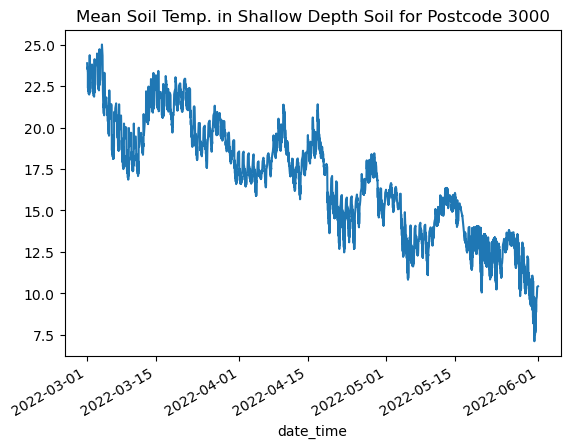

In [60]:
# TODO: So maybe consider limiting the dataset to 1 month to make the timeseries plot cleaner.
# map per postcode in a bokeh, this will allow us to turn on which ones we want to compare!
# Then in the background we have the BOM ambient temperature.

# Isolate the dataset to only be sensors for the postcode defined.
df_sensor_pc3000 = df_pcode_sensor_depth_filtered_0322[df_pcode_sensor_depth_filtered_0322['name'] == 3000]

# We need to find the mean or median for the sensor values within the postcode for the same timestamp
df_sensor_pc3000_grouped_time = df_sensor_pc3000.groupby('date_time')
mean_values = df_sensor_pc3000_grouped_time['soil_value'].mean()

mean_values.plot(title = 'Mean Soil Temp. in Shallow Depth Soil for Postcode 3000')
plt.show()


In [61]:
# To easier see comparative trends we will just do it for for 2 days for example, it is easier to notice the fluctuations then. 2 Days is good because we also see a full night to day cycle:
# We will use the above 3 month plot to select a good set of days to compare (also a bit of trail and error)
start_date = '2022-04-15 00:00:00'
end_date = '2022-04-17 00:00:00'


time_mask_mean = (mean_values.index > start_date) & (mean_values.index <= end_date)

mean_values_3000_041516 = mean_values.loc[time_mask_mean]

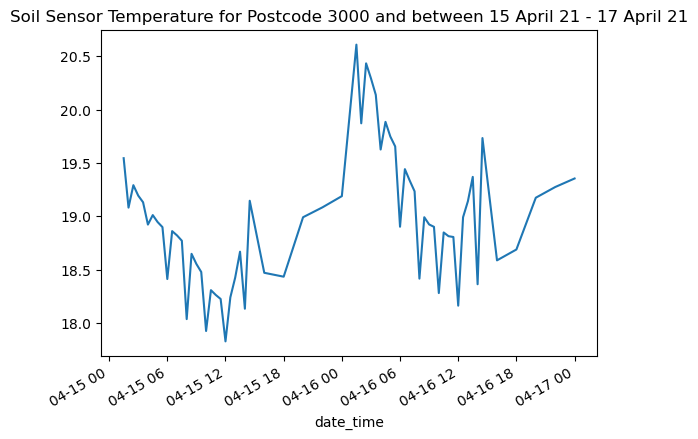

In [62]:
mean_values_3000_041516.plot(title = 'Soil Sensor Temperature for Postcode 3000 and between 15 April 21 - 17 April 21')
plt.show()

Trying with normal interpolation

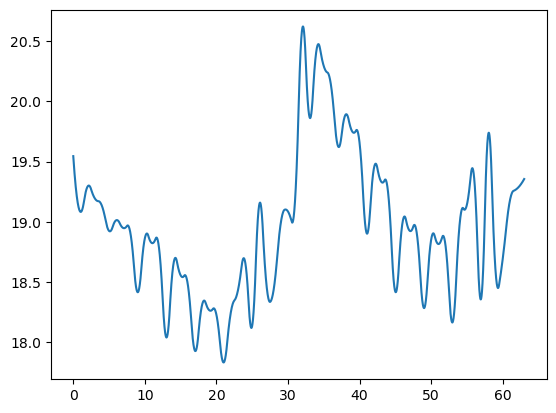

In [63]:
from scipy import interpolate

n = len(mean_values_3000_041516.index)
x_map = np.arange(0, n)
dx = 0.001
x_int = np.arange(0, n-1, dx)

interpolate_temp = interpolate.interp1d(x_map, mean_values_3000_041516.values, 'quadratic')
vals = interpolate_temp(x_int)

plt.plot(x_int, vals )
plt.show()


## LOESS and Bokeh plot

In [64]:
# USING LOESS / Locally Weighted Linear Regression to get a nicer curve:
import statsmodels.api as sm

df_loess_mean_3000 = pd.DataFrame() #Empty dataframe init
df_loess_mean_3000['datetime'] = mean_values_3000_041516.index
df_loess_mean_3000['datetime'] = pd.to_datetime(df_loess_mean_3000['datetime'])

df_loess_mean_3000['soil_temp'] = mean_values_3000_041516.values
#y = mean_values_3000_041516.values
#lowess = sm.nonparamentric.lowess(y, x, frac=0.3)



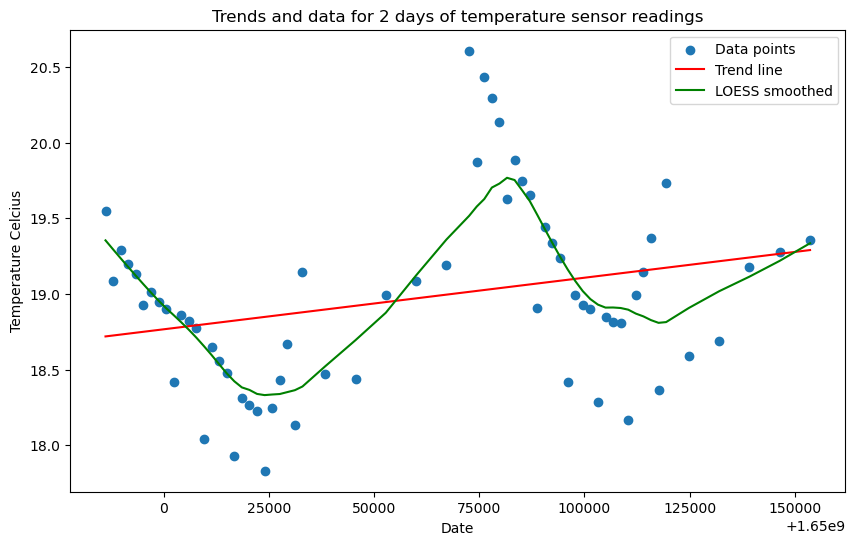

In [65]:
import scipy.stats as stats
import datetime as dt
from statsmodels.nonparametric.smoothers_lowess import lowess


dateconvert = mean_values_3000_041516.index.astype('int64') / 10**9
#LOESS
smoothed = lowess(mean_values_3000_041516.values, dateconvert, frac=0.275)
#Linear regression:
slope, y_intercept, _, _, _ = stats.linregress(dateconvert, mean_values_3000_041516.values)
trend_line = lambda x: slope * x + y_intercept

plt.figure(figsize=(10, 6))
plt.scatter(dateconvert, mean_values_3000_041516.values, label='Data points')
plt.plot(dateconvert, trend_line(dateconvert), color='red', label='Trend line')

plt.plot(smoothed[:, 0], smoothed[:, 1], label='LOESS smoothed', color='green')

plt.xlabel('Date')
plt.ylabel('Temperature Celcius')
plt.title('Trends and data for 2 days of temperature sensor readings')
plt.legend()
plt.show()

### LOESS smoothing to find the trend of the sensor data with Bokeh Code
Now we can create a Bokeh plot of all postcode data.

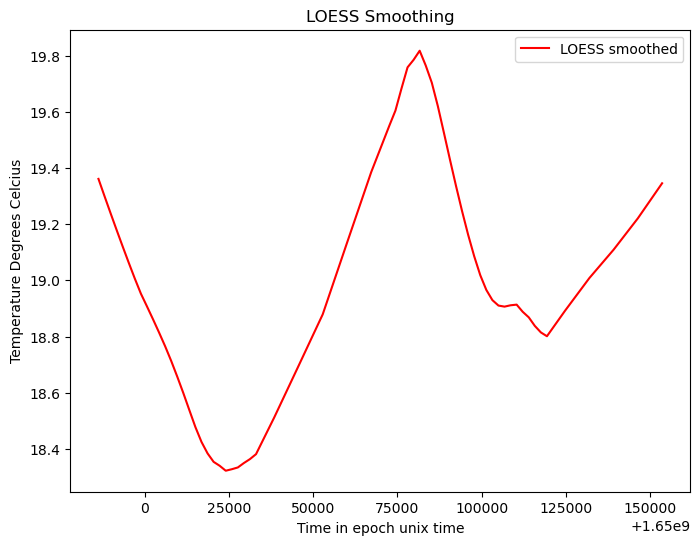

In [66]:
smoothed = lowess(mean_values_3000_041516.values, dateconvert, frac=0.25)

# Plot the original data and smoothed curve
plt.figure(figsize=(8, 6))

plt.plot(smoothed[:, 0], smoothed[:, 1], label='LOESS smoothed', color='red')
plt.xlabel('Time in epoch unix time')
plt.ylabel('Temperature Degrees Celcius')
plt.title('LOESS Smoothing')
plt.legend()
plt.show()

In [67]:
# Loops to fill the plot:
# Time limit the original dataset:

df_pcode_sensor_depth_filtered_0322

start_date = '2022-04-15 00:00:00'
end_date = '2022-04-17 00:00:00'


time_mask_mean = (df_pcode_sensor_depth_filtered_0322['date_time'] > start_date) & (df_pcode_sensor_depth_filtered_0322['date_time'] <= end_date)

df_pcode_sensor_depth_filtered_041516 = df_pcode_sensor_depth_filtered_0322.loc[time_mask_mean]

In [68]:
# Generating a Bokeh using the framework of the code above.
import itertools
from bokeh.plotting import figure
from bokeh.models import FactorRange, ColumnDataSource
from bokeh.plotting import figure, show, output_notebook
from bokeh.palettes import plasma


# Assuming 'hours' is a list of strings representing each hour ['1', '2', '3', ..., '24']
#hours = [str(hour) for hour in range(1, 25)]
# Create a figure with a title and label axes, omitting the plot_height and plot_width directly if they cause issues
p = figure(title="LOESS for Avg. Soil Temp. in a Postcode over time",
           x_axis_label='Epoch Unix time starting 2022-04-15 00:00:00 & ending 2022-04-17 00:00:00',
           y_axis_label='Temperature Degrees Celcius')
           #x_range=FactorRange(factors=hours))  # Using FactorRange to set x_range for categorical data

# Display options
p.height = 700
p.width = 1000
p.title.align = 'center'
p.title.text_font_size = '16pt'
p.xaxis.major_label_orientation = 1 




In [69]:
postcode_list = ["3000","3002","3003","3004","3006","3008","3010","3141", "3053", "3052", "3054"]
lines = {}
# Colours

colours = itertools.cycle(plasma(13))


for indx, postcode in enumerate(postcode_list):
    print("POSTCODE-----------------------------------------", postcode)
    df_postcode = df_pcode_sensor_depth_filtered_041516[df_pcode_sensor_depth_filtered_041516['name'] == int(postcode)]
    
    df_postcode_grouped = df_postcode.groupby('date_time')
    
    mean_values = df_postcode_grouped['soil_value'].mean()
    
    #convert datetime to epoch
    dateconverted2 = mean_values.index.astype('int64') / 10**9

    #LOESS
    smoothed2 = lowess(mean_values.values, dateconverted2, frac=0.3)

    #Populate the Bokeh chart
    p.line(smoothed2[:, 0], smoothed2[:, 1], legend_label=postcode, muted_alpha=0.2, muted=True, line_width=4, line_cap='butt', color=next(colours))

    
p.legend.click_policy="mute"



POSTCODE----------------------------------------- 3000
POSTCODE----------------------------------------- 3002
POSTCODE----------------------------------------- 3003
POSTCODE----------------------------------------- 3004
POSTCODE----------------------------------------- 3006
POSTCODE----------------------------------------- 3008
POSTCODE----------------------------------------- 3010
POSTCODE----------------------------------------- 3141
POSTCODE----------------------------------------- 3053
POSTCODE----------------------------------------- 3052
POSTCODE----------------------------------------- 3054


In [108]:
from bokeh.io import output_file, save
output_file("output.html")
save(p)

'e:\\DTU\\S2_2024\\SocialData\\Assignments\\FinalProj\\GIT\\SocialDataFinalProject\\output.html'

In [70]:
show(p)

## Barplot code showing relationship of tree coverage to mean temperature

Using the beautiful spatially joined data, that took the sum of tree area coverage (by polygon that represented canopy coverage) by postcode, then divided by total postcode area to find percentage of the tree coverage.

In [72]:
# Import the dataset:
df_treearea_pc = pd.read_csv('E:/DTU/S2_2024/SocialData/Assignments/FinalProj/Datasets/treearea_percentage.csv')

# Sort by percentage in ascending
df_treearea_pc_sorted = df_treearea_pc.sort_values(by='percentage')



### Data cleaning and spatial joining:

In [74]:
# Get the mean values for temperature over the year:
df_temp_over_year = df_cloned_before_timelimit#clone the df so we don't mess anything up

#Redo the spatial join with postcodes for the entire year data:
df_temp_over_year['location'] = df_temp_over_year.apply(lambda row: Point(row.longitude, row.latitude), axis=1)
gdf_new = gpd.GeoDataFrame(df_soil22_temperature_clean_filterdepth, geometry='location')

df_temp_over_year_spatial = gpd.sjoin(gdf_sensors, melb_subdistricts, how="left", op='within')

C:\Users\mikus\AppData\Local\Temp\ipykernel_6568\2689402582.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp_over_year['location'] = df_temp_over_year.apply(lambda row: Point(row.longitude, row.latitude), axis=1)
c:\Users\mikus\anaconda3\envs\course02502\lib\site-packages\IPython\core\interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
C:\Users\mikus\AppData\Local\Temp\ipykernel_6568\2689402582.py:8: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Check for any unnassigned postcodes which would result in NaN

In [75]:
nan_rows = df_temp_over_year_spatial.isna()
# To get the rows with any NaN values
rows_with_nan = nan_rows.any(axis=1)
# To display the rows with NaN values
df_temp_over_year_spatial[rows_with_nan]

,date_time,site_name,site_id,id,date,time,probe_id,probe_measure,soil_value,unit,json_featuretype,latitude,longitude,location,index_right,name


Group by the postcode which is actually titled name in the col (sorry) and find mean.

In [76]:
df_temp_over_year_spatial.head()

,date_time,site_name,site_id,id,date,time,probe_id,probe_measure,soil_value,unit,json_featuretype,latitude,longitude,location,index_right,name
1601,2022-04-16 08:30:00,Princess bridge SW p10,101034,12116499,2022-04-16,18:30:00,2019282,Soil Temperature 10cm,19.22,ºC,SoilSensorData,-37.819897,144.968499,POINT (144.96850 -37.81990),47,3006
1619,2022-04-16 11:00:00,Royal Parade Opposite Lawn 5,91577,12116544,2022-04-16,21:00:00,2031627,Soil Temperature 10cm,16.40,ºC,SoilSensorData,-37.780909,144.960163,POINT (144.96016 -37.78091),57,3054
1625,2022-04-16 11:30:00,Princess bridge NE p11,101037,12116580,2022-04-16,21:30:00,2019343,Soil Temperature 10cm,18.32,ºC,SoilSensorData,-37.818811,144.968165,POINT (144.96817 -37.81881),42,3000
1971,2022-04-16 14:30:00,Princess bridge NW p01,101032,12116795,2022-04-17,00:30:00,2019262,Soil Temperature 10cm,19.74,ºC,SoilSensorData,-37.818868,144.967975,POINT (144.96798 -37.81887),42,3000
1987,2022-04-16 06:30:00,Bourke South 3,88425,12116863,2022-04-16,16:30:00,1914087,Soil Temperature 10cm,19.87,ºC,SoilSensorData,-37.813741,144.965109,POINT (144.96511 -37.81374),42,3000


In [77]:
df_temp_over_year_spatial_groupedmean = df_temp_over_year_spatial.groupby('name')['soil_value'].mean()

In [78]:
df_temp_over_year_spatial_groupedmean

name
3000    16.482008
3002    15.617096
3003    15.279205
3004    16.029819
3006    15.928846
3008    16.067692
3010    14.558149
3052    16.064085
3053    16.889902
3054    15.337583
3141    15.448713
Name: soil_value, dtype: float64

In [79]:
# Limit the tree canopy data to match the postcodes in the soil temps
postcodes_list = df_temp_over_year_spatial_groupedmean.index.tolist()
postcodes_list = [int(i) for i in postcodes_list]
df_treearea_pc_sorted_reduced = df_treearea_pc_sorted[df_treearea_pc_sorted['name'].isin(postcodes_list)]


In [80]:
df_treearea_pc_sorted_reduced

,name,year,shape_area,percentage
6,3008,2021,104488.166338,2.564134
7,3010,2021,131193.231874,3.219474
5,3006,2021,133802.810564,3.283513
12,3054,2021,169220.126052,4.152652
2,3003,2021,195396.648606,4.795023
14,3141,2021,257883.925992,6.328457
11,3053,2021,266367.755502,6.536649
0,3000,2021,279300.294744,6.854013
1,3002,2021,452090.194089,11.094267
3,3004,2021,648576.174946,15.916022


In [81]:
#Convert postcode to int
df_temp_over_year_spatial_groupedmean.index = df_temp_over_year_spatial_groupedmean.index.astype(int)

In [82]:
# Now we have one dataframe sorted by percentage are and temp
df_merged = df_treearea_pc_sorted_reduced.merge(df_temp_over_year_spatial_groupedmean, left_on='name', right_on='name', how='left')

### Generating the bar plot with LOESS included

(14.0, 18.0)

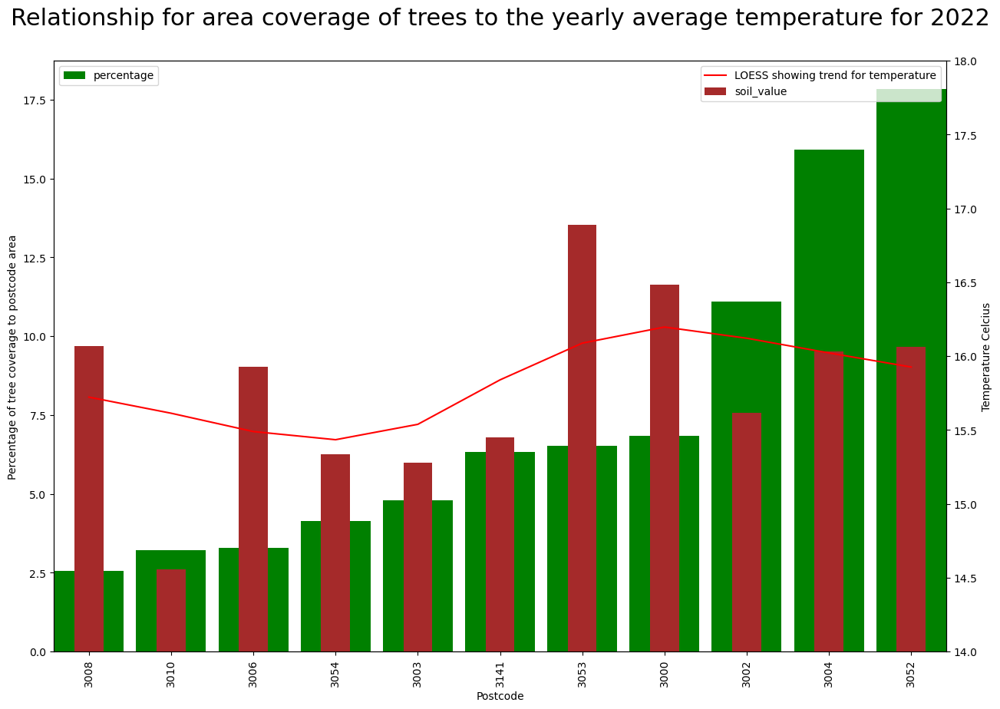

In [83]:
fig = plt.figure(figsize=(15,10)) # Create matplotlib figure

ax = fig.add_subplot() # Create matplotlib axes
ax2 = ax.twinx()

ax.set_title('Relationship for area coverage of trees to the yearly average temperature for 2022', fontsize='22', y=1.05) 

df_merged.plot(ax=ax, kind='bar', color='green', width=0.85, x='name', y='percentage', ylabel='Percentage of tree coverage to postcode area', legend=True, xlabel='Postcode')
df_merged.plot(kind='bar', ax=ax2, width=0.35, color='brown', x='name', y='soil_value', ylabel='Temperature Celcius', legend=True)

#Linear regression:
smoothed_line = lowess(df_merged['soil_value'], df_merged.index, frac=0.7)

plt.plot(smoothed_line[:,0], smoothed_line[:, 1], color='red', label='LOESS showing trend for temperature')
plt.legend()
ax.legend(loc='upper left')
ax2.set_ylim([14,18])